<a href="https://colab.research.google.com/github/samuhin/TimeSeries/blob/main/TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Установка и импортирование библиотек

##Устанавливаем yfinance для скачивание данных котировок

In [ ]:
!pip install yfinance

     |████████████████████████████████| 5.5MB 15.8MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.55-py2.py3-none-any.whl size=22616 sha256=dcef5005d08e6ac57bd82b09008f6e35969669da67de95e54539aa84b1c4c46f
  Stored in directory: /root/.cache/pip/wheels/04/98/cc/2702a4242d60bdc14f48b4557c427ded1fe92aedf257d4565c
Successfully built yfinance
  Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


##Импортируем основные библиотеки

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras.layers import LSTM
from keras.layers import GRU
from keras.layers import SimpleRNN
from sklearn.linear_model import LinearRegression

##Для того, чтобы изображения были чётче

In [ ]:
%config InlineBackend.figure_format = 'retina'

#Загрузка данных и предобработка данных

##Загрузка

Выбираем временной промежуток

In [ ]:
start_date = '2017-01-01'
end_date = '2020-12-31'

Загружаем данные

In [ ]:
 data = yfinance.download("AUDUSD=X CADUSD=X CHFUSD=X \
                          CNYUSD=X DKKUSD=X EURUSD=X \
                          GBPUSD=X HKDUSD=X JPYUSD=X \
                          KZTUSD=X NOKUSD=X NZDUSD=X \
                          PLNUSD=X RUBUSD=X SEKUSD=X",
                        start=start_date, end=end_date)

[*********************100%***********************]  15 of 15 completed


Посмотрим на скачанные данные (закрытие)

In [ ]:
 data['Close'].head()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
Date,,,,,,,,,,,,,,,
2017-01-02,0.720981,0.744380,0.981653,0.144013,0.141589,1.052698,1.234903,0.128949,0.008562,0.003012,0.115845,0.693433,0.239261,0.016332,0.110110
2017-01-03,0.719683,0.743970,0.976381,0.144009,0.140689,1.046003,1.228199,0.128901,0.008511,0.003022,0.115547,0.693193,0.237208,0.016332,0.109632
2017-01-04,0.722993,0.745057,0.974564,0.143682,0.140155,1.041992,1.224560,0.128927,0.008499,0.003028,0.115737,0.692377,0.237595,0.016414,0.109269
2017-01-05,0.728704,0.751936,0.980277,0.144402,0.141231,1.050089,1.232681,0.128950,0.008539,0.003036,0.116524,0.696330,0.240393,0.016566,0.109964
2017-01-06,0.733837,0.755892,0.990305,0.145182,0.142680,1.060592,1.242545,0.128959,0.008676,0.003062,0.117927,0.702149,0.243142,0.016835,0.111151


Посмотрим описание данных

In [ ]:
 data['Close'].describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1041.000000,1041.000000,1041.000000,1040.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000
mean,0.725074,0.760749,1.028044,0.147316,0.153382,1.143149,1.296206,0.128126,0.009131,0.002765,0.116164,0.678256,0.265209,0.015632,0.111850
std,0.042771,0.021876,0.032816,0.004933,0.006193,0.045563,0.046467,0.000612,0.000232,0.000280,0.007829,0.034812,0.013245,0.001407,0.006771
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095796
25%,0.694589,0.749327,1.005429,0.143984,0.148770,1.110803,1.265663,0.127516,0.008954,0.002590,0.110956,0.655888,0.257513,0.014922,0.106343
50%,0.722857,0.759013,1.018237,0.145862,0.152396,1.137139,1.295404,0.127986,0.009121,0.002675,0.116873,0.677282,0.264423,0.015661,0.111501
75%,0.758438,0.772320,1.039825,0.150357,0.158170,1.177413,1.320603,0.128791,0.009298,0.003036,0.121883,0.703769,0.272201,0.016893,0.115650
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


##Предобработка

Заполним пропуски в данных

In [ ]:
 new_data = data['Close'].interpolate(method='polynomial', order=3)

Посмотрим на результаты заполнения

In [ ]:
 new_data.describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000,1041.000000
mean,0.725074,0.760749,1.028044,0.147311,0.153382,1.143149,1.296206,0.128126,0.009131,0.002765,0.116164,0.678256,0.265209,0.015632,0.111850
std,0.042771,0.021876,0.032816,0.004933,0.006193,0.045563,0.046467,0.000612,0.000232,0.000280,0.007829,0.034812,0.013245,0.001407,0.006771
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095796
25%,0.694589,0.749327,1.005429,0.143982,0.148770,1.110803,1.265663,0.127516,0.008954,0.002590,0.110956,0.655888,0.257513,0.014922,0.106343
50%,0.722857,0.759013,1.018237,0.145862,0.152396,1.137139,1.295404,0.127986,0.009121,0.002675,0.116873,0.677282,0.264423,0.015661,0.111501
75%,0.758438,0.772320,1.039825,0.150351,0.158170,1.177413,1.320603,0.128791,0.009298,0.003036,0.121883,0.703769,0.272201,0.016893,0.115650
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


#Подготовка к анализу данных как временного ряда

Напишем функция для преобразование данных в удобную форму для работы с ними

In [ ]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

Введём дополнительные регрессоры (если нужно)

In [ ]:
#new_data['day'] = new_data.index.day
#new_data['month'] = new_data.index.month

Переведём данные в numpy-массив:

In [ ]:
values = new_data.values
values

array([[0.72098053, 0.74437994, 0.98165292, ..., 0.23926078, 0.01633152,
        0.11011021],
       [0.71968335, 0.7439701 , 0.97638136, ..., 0.23720796, 0.01633232,
        0.1096323 ],
       [0.7229926 , 0.74505657, 0.97456384, ..., 0.2375946 , 0.01641416,
        0.10926872],
       ...,
       [0.7588923 , 0.77881616, 1.12574577, ..., 0.27210587, 0.01352622,
        0.1210579 ],
       [0.76098865, 0.77990347, 1.13109374, ..., 0.26990843, 0.01350961,
        0.12188224],
       [0.76892906, 0.7842707 , 1.13432705, ..., 0.2686179 , 0.01341886,
        0.12211846]])

Посмотрим какая у него размерность

In [ ]:
values.shape 

(1041, 15)

Сделаем преобразование MinMaxScale для данных

In [ ]:
# ensure all data is float
values = values.astype('float32')
# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

Посмотрим что получилось:

In [ ]:
 scaled

array([[0.6179085 , 0.4011469 , 0.04437256, ..., 0.08463311, 0.7072511 ,
        0.4511826 ],
       [0.6124444 , 0.39813805, 0.01137638, ..., 0.05428648, 0.70739365,
        0.4361186 ],
       [0.626384  , 0.40611458, 0.        , ..., 0.06000233, 0.7219608 ,
        0.4246583 ],
       ...,
       [0.77760553, 0.6539693 , 0.94628763, ..., 0.57018065, 0.20794702,
        0.7962637 ],
       [0.7864361 , 0.661952  , 0.9797621 , ..., 0.5376959 , 0.20499039,
        0.822248  ],
       [0.8198838 , 0.6940155 , 1.        , ..., 0.5186181 , 0.18883777,
        0.82969356]], dtype=float32)

#Разделение выборки на обучающую и тестовую

In [ ]:
# specify the number of lag hours
n_hours = 3
n_features = scaled.shape[1]
n_predict = 1

# frame as supervised learning
reframed = series_to_supervised(scaled, n_hours, n_predict)

# split into train and test sets
values = reframed.values
n_train_hours = 500
train = values[:n_train_hours, :]
test = values[n_train_hours:, :]

# split into input and outputs
n_obs = n_hours * n_features
train_X, train_y = train[:, :n_obs], train[:, n_obs:]
test_X, test_y = test[:, :n_obs], test[:, n_obs:]
  
# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))

#Анализ

##Метрики

In [ ]:
import ml_metrics as metrics

###RMSE

In [ ]:
def RMSE(y_hat, y_pred):
  pass
  return metrics.rmse(y_hat, y_pred)

###MAE

In [ ]:
def MAE():
  pass
  return metrics.mae(y_hat, y_pred)

##Наивный алгоритм

Составляем предсказание

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:][-1]])))
    y_pred.append(temp_pred[-1])
  i = i + n

Выполяем обратное преобразование

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график предсказания

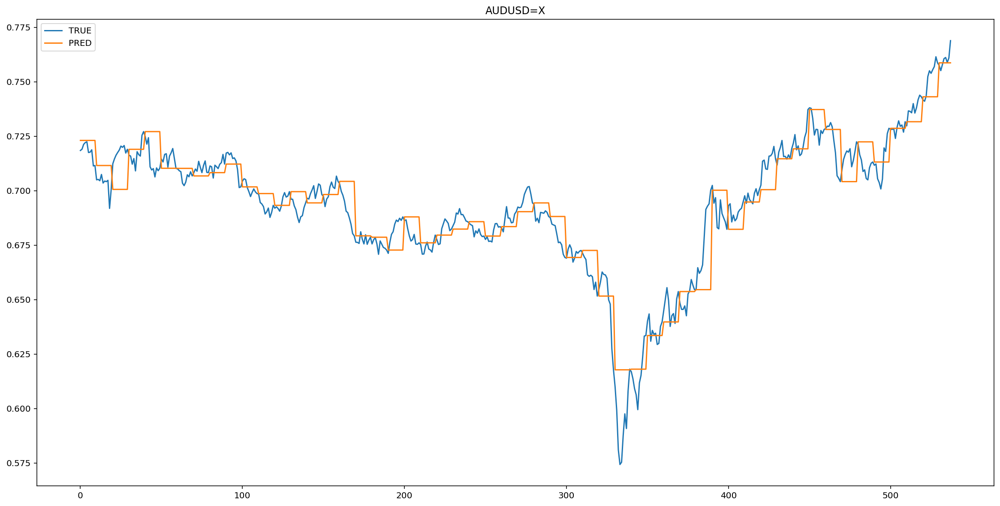

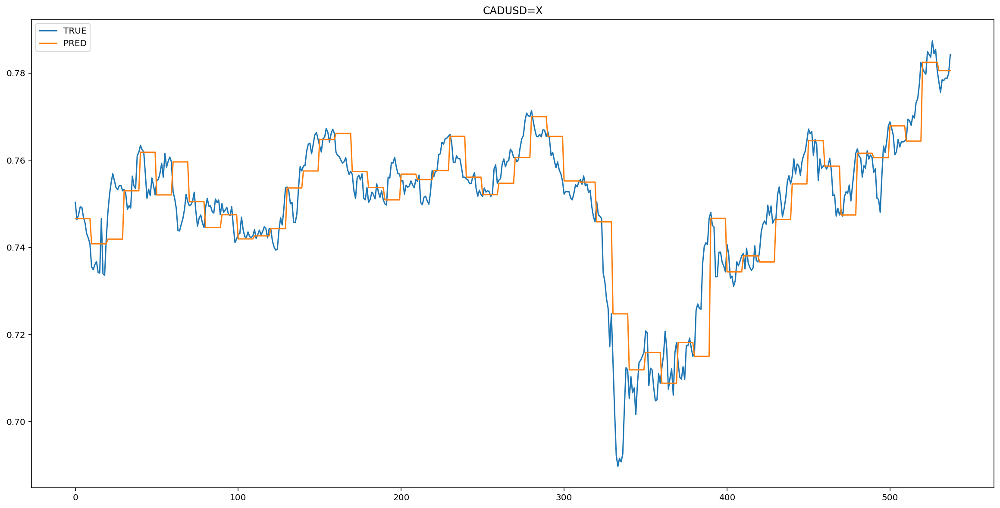

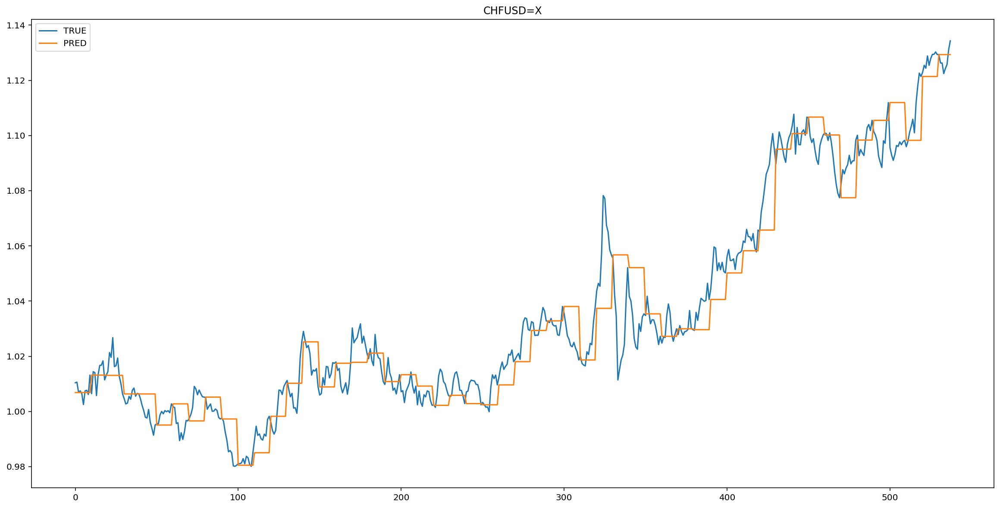

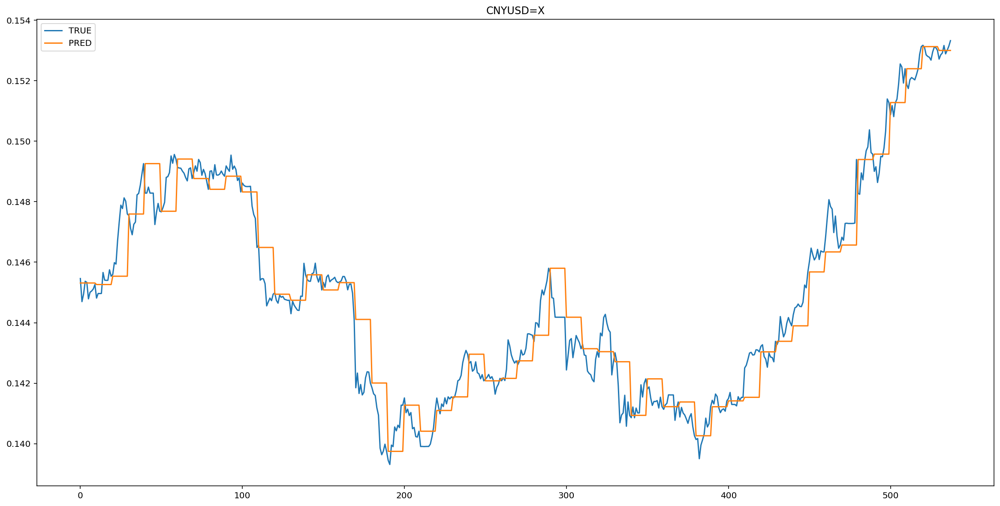

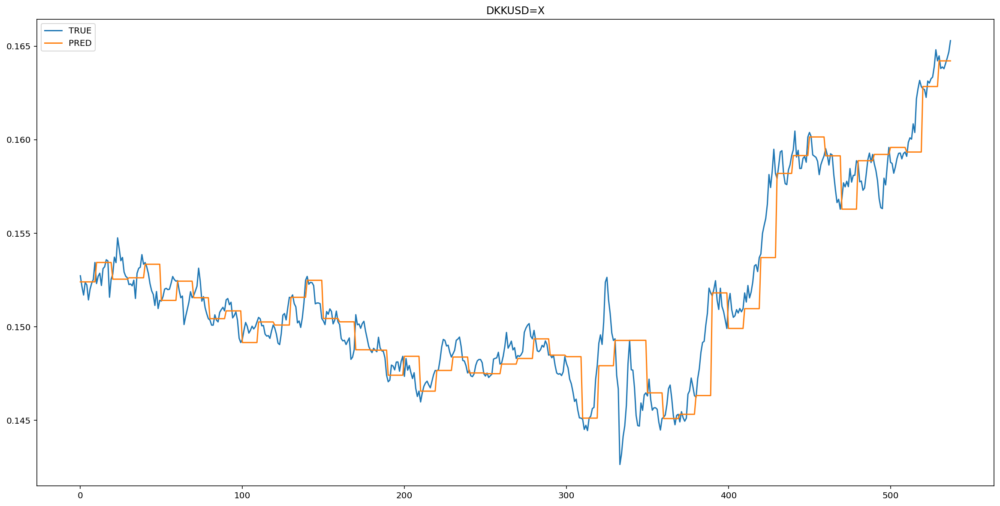

...

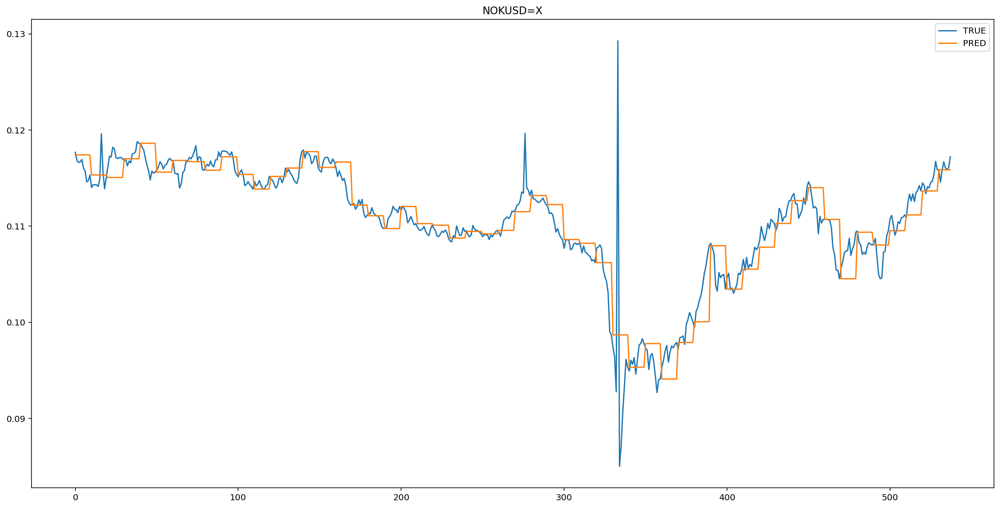

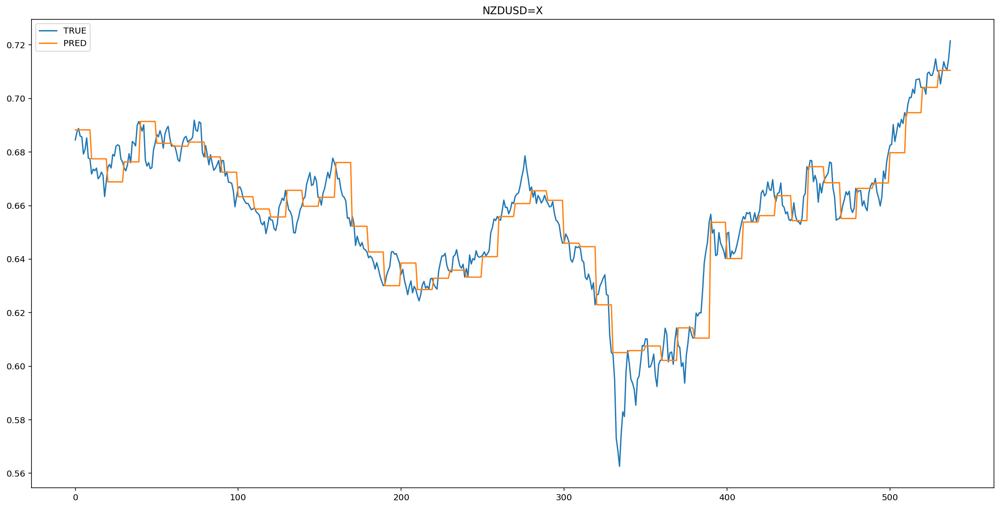

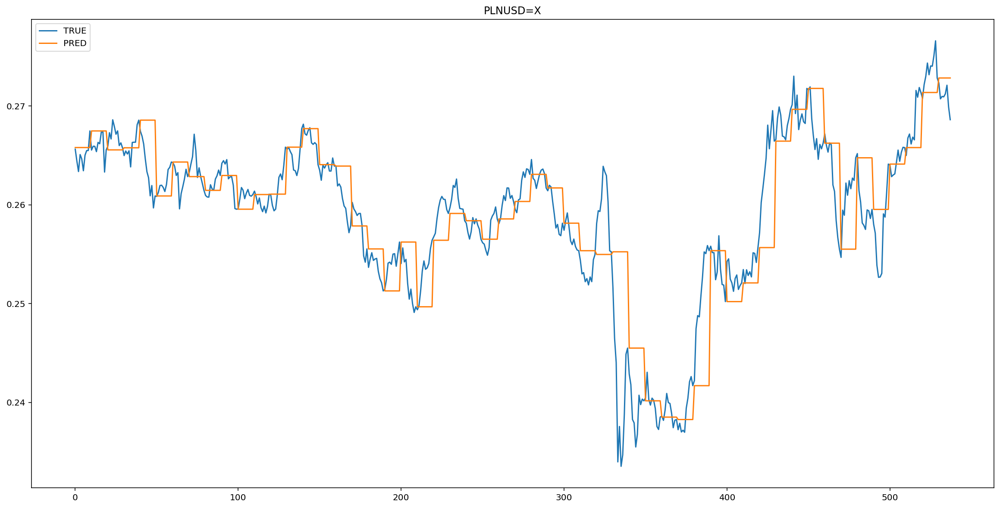

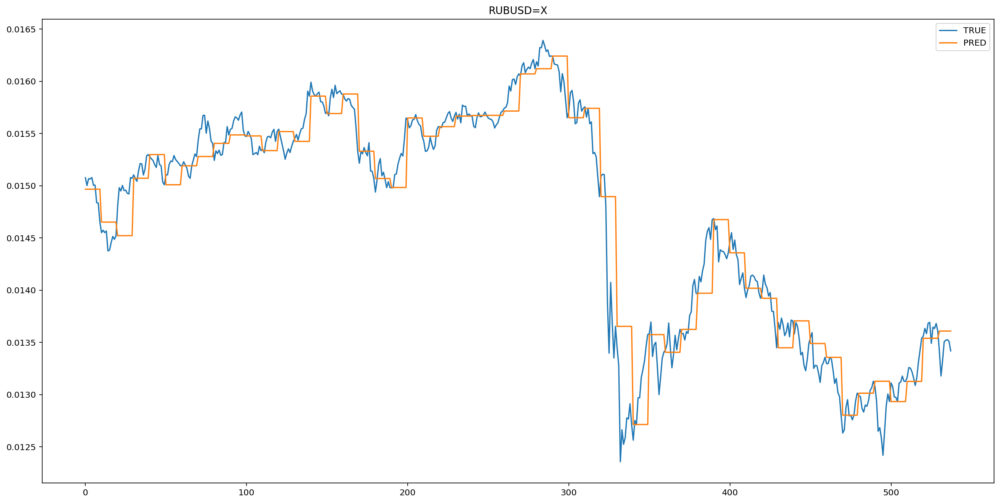

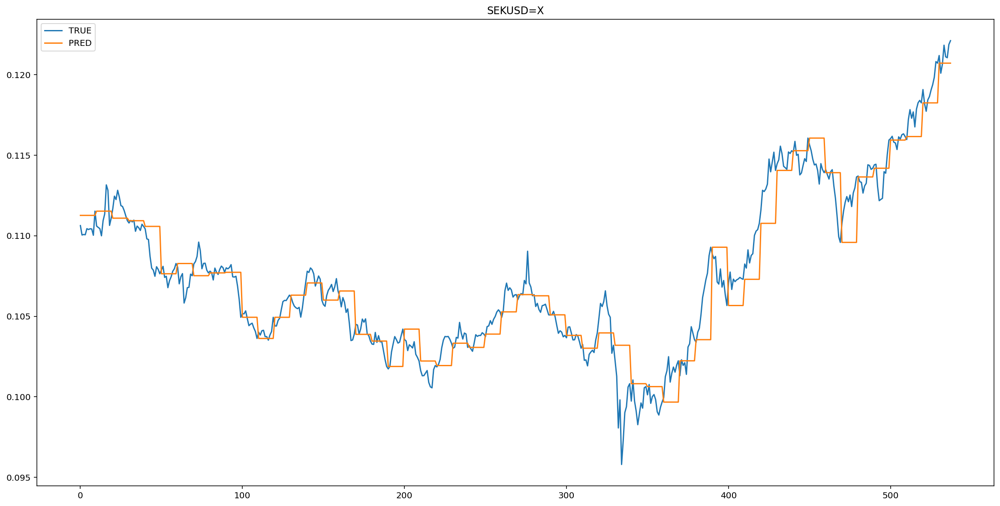

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

##Среднее

###Простое среднее

Составляем предсказание

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.array([temp_pred[-n:].mean(axis = 0)]) #простое среднее
    y_pred.append(temp_pred[-1])
  i = i + n

Делаем обратное предсказание

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим графики

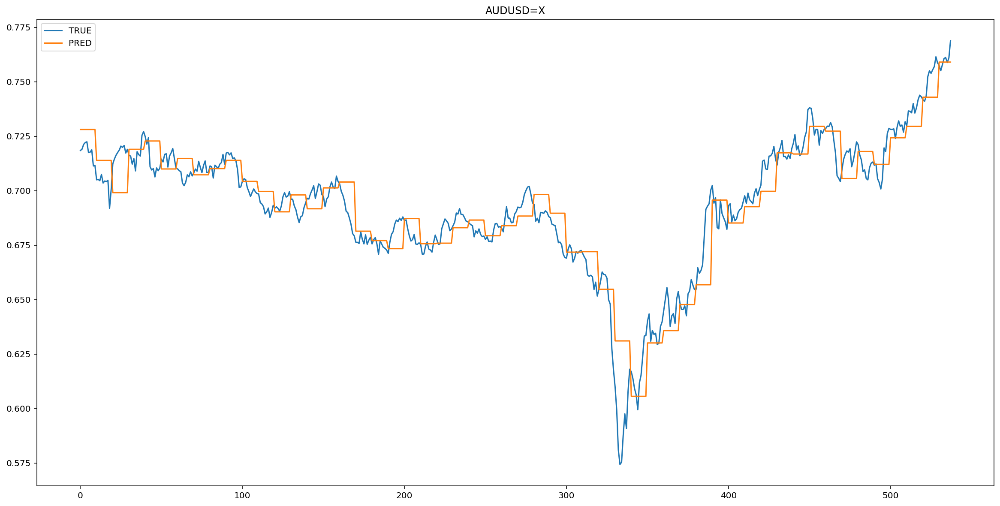

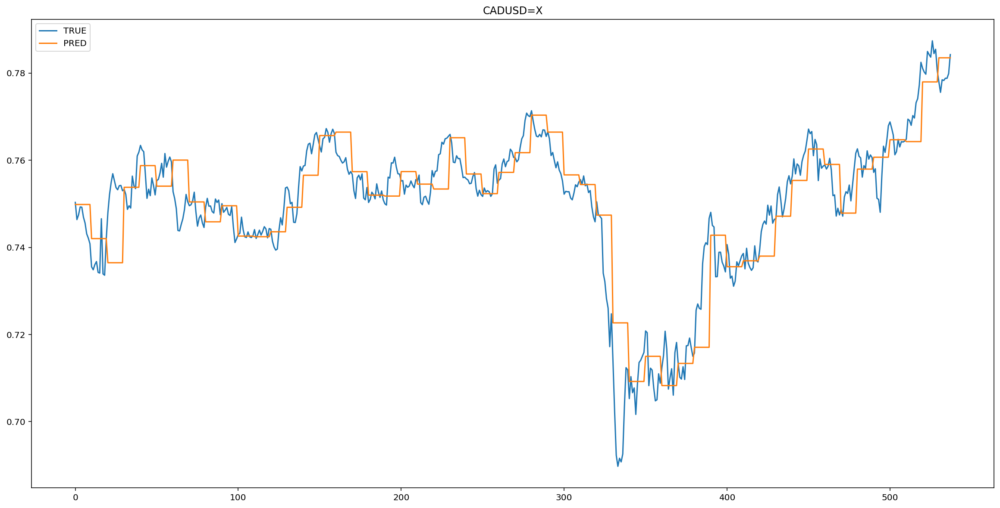

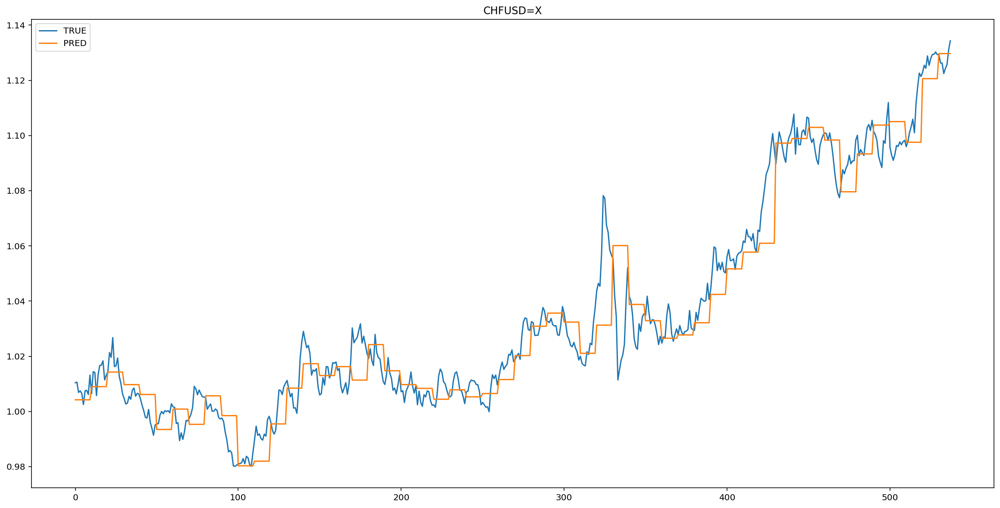

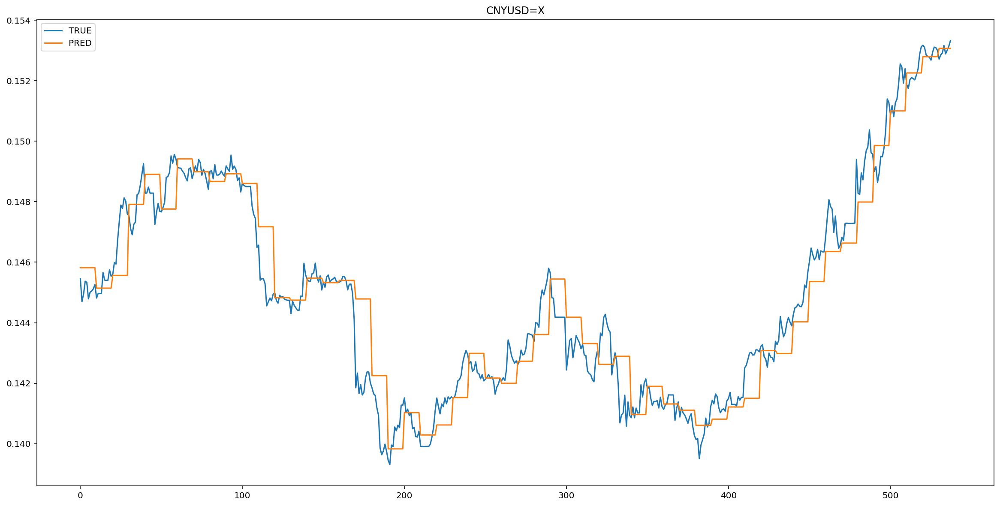

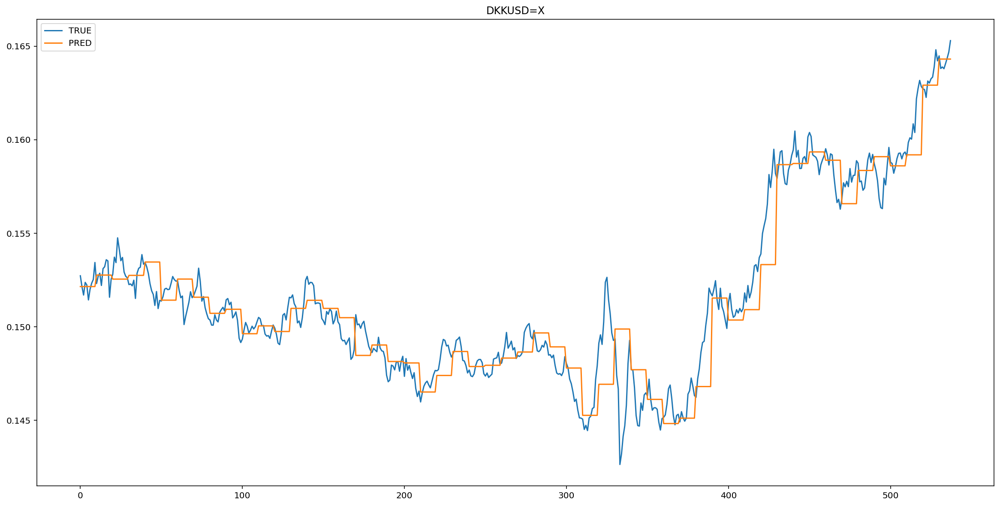

...

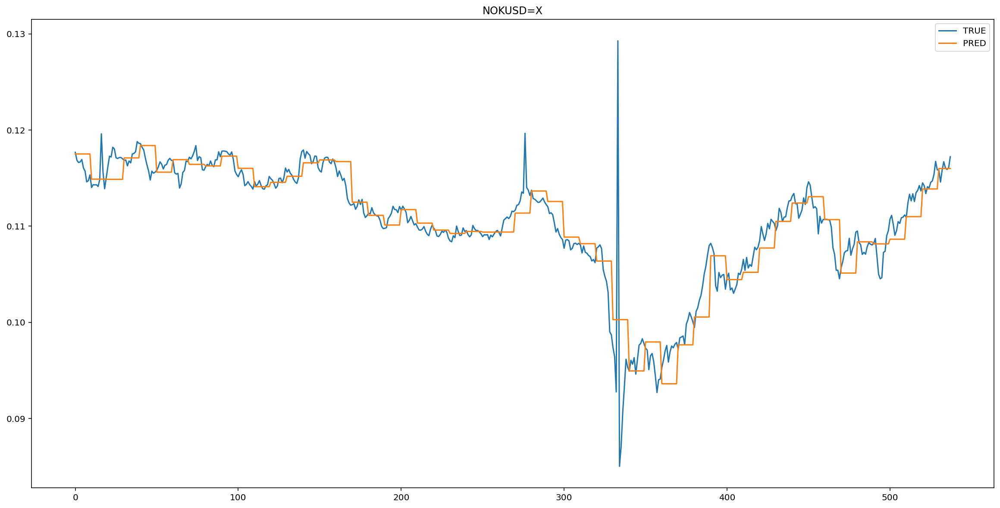

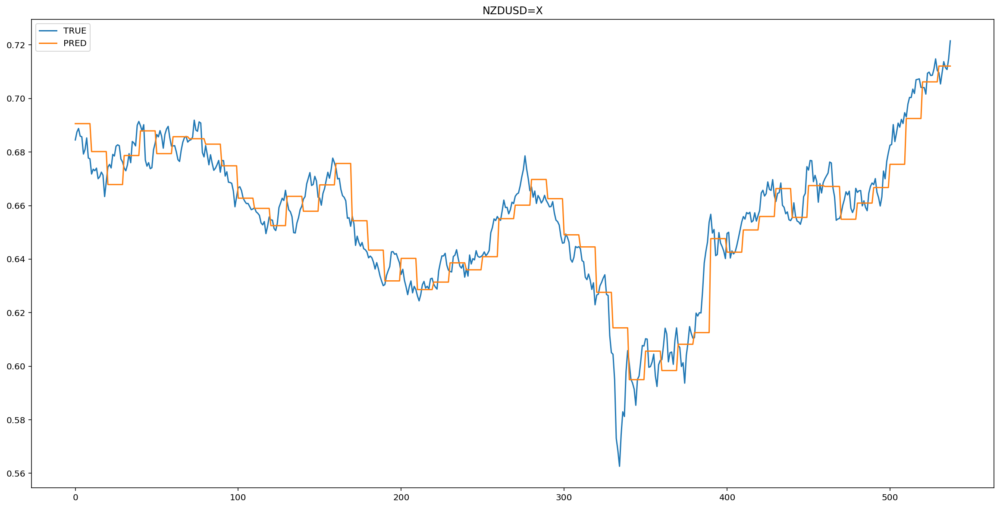

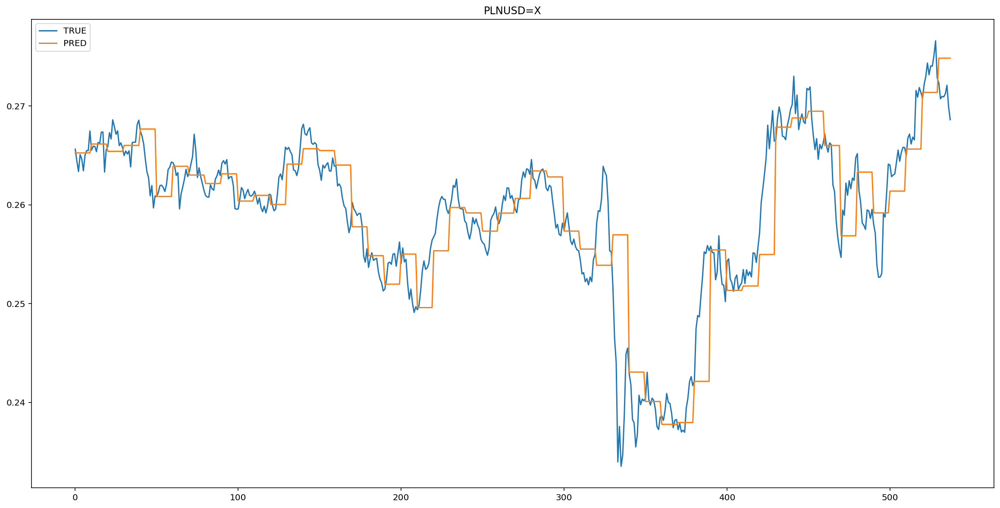

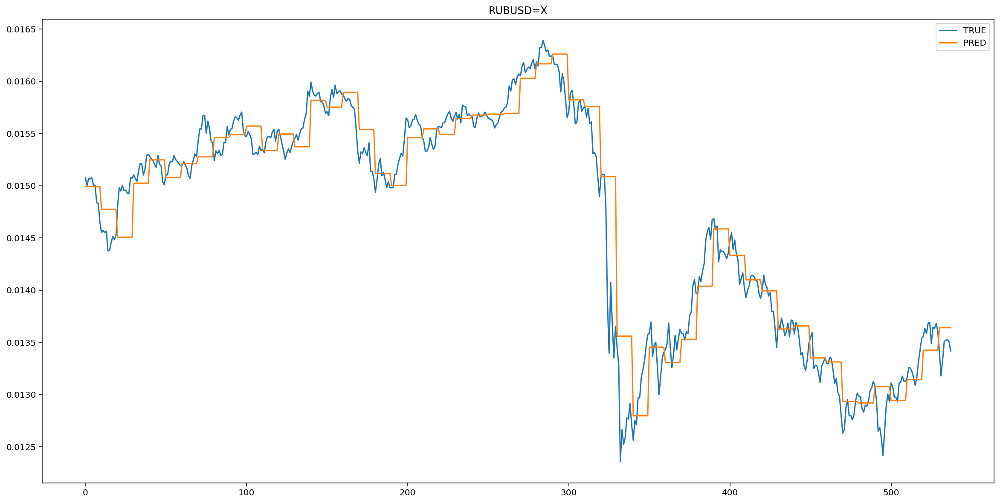

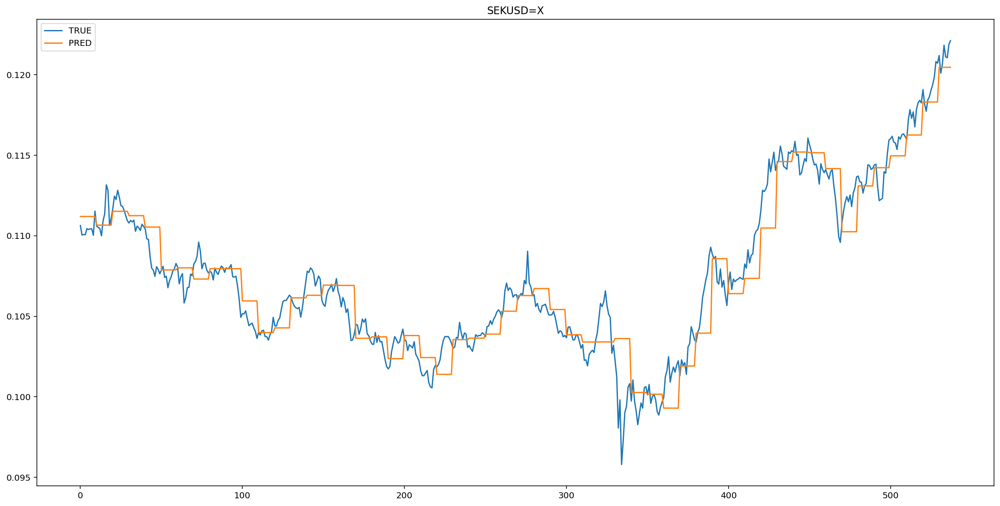

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

###Скользящее среднее

Составляем прогноз

In [ ]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:].mean(axis = 0)]))) #скользящее среднее
    y_pred.append(temp_pred[-1])
  i = i + n


Делаем обратное преобразование

In [ ]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график

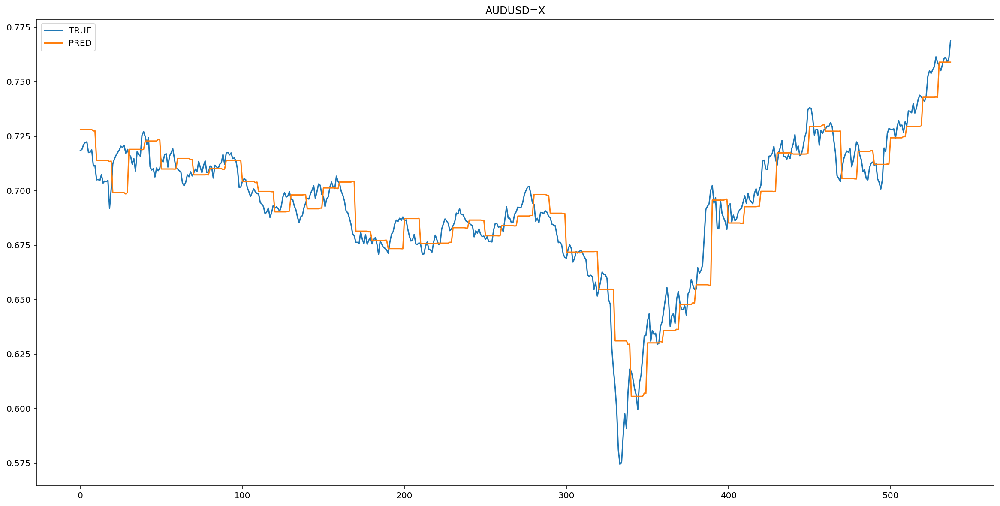

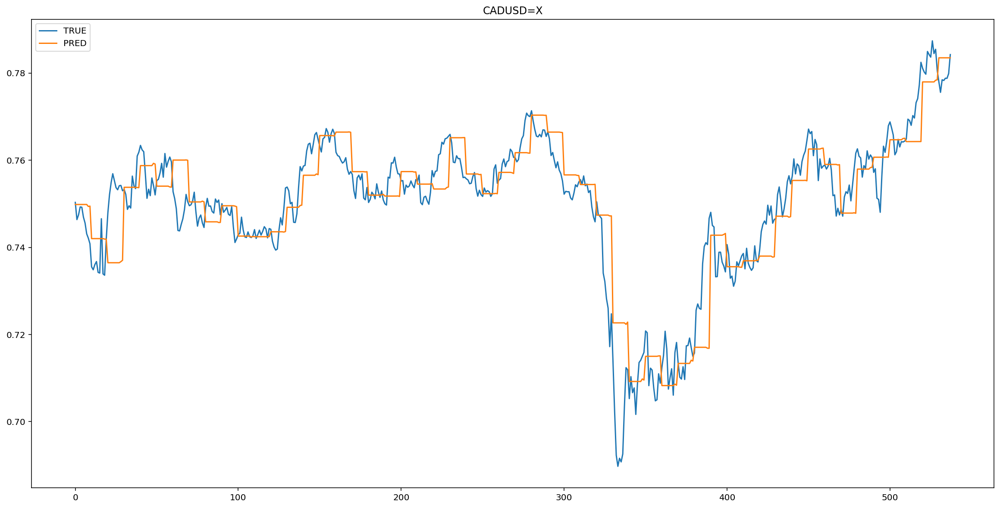

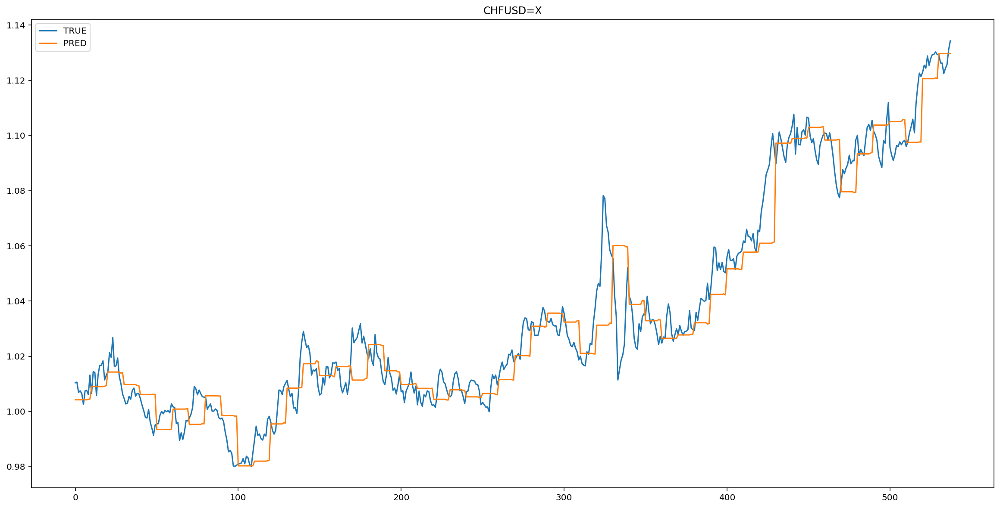

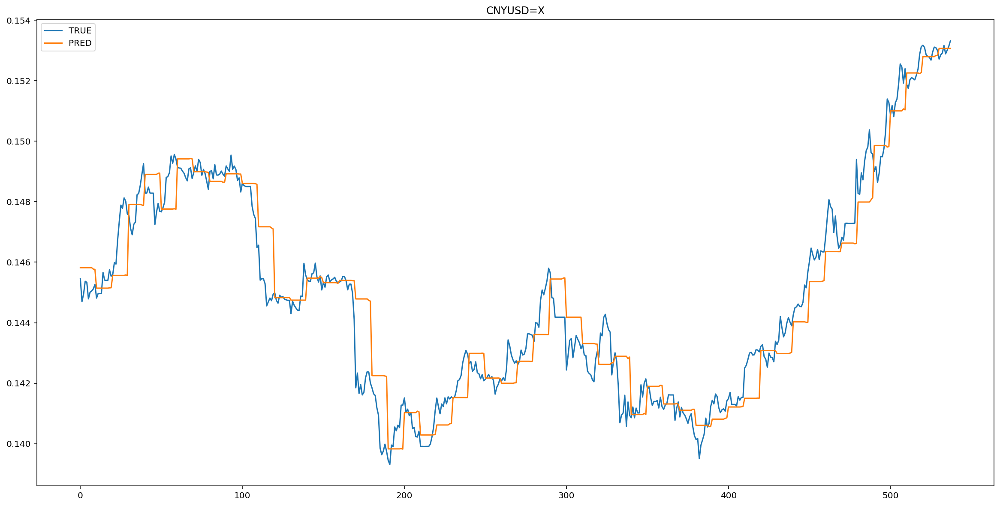

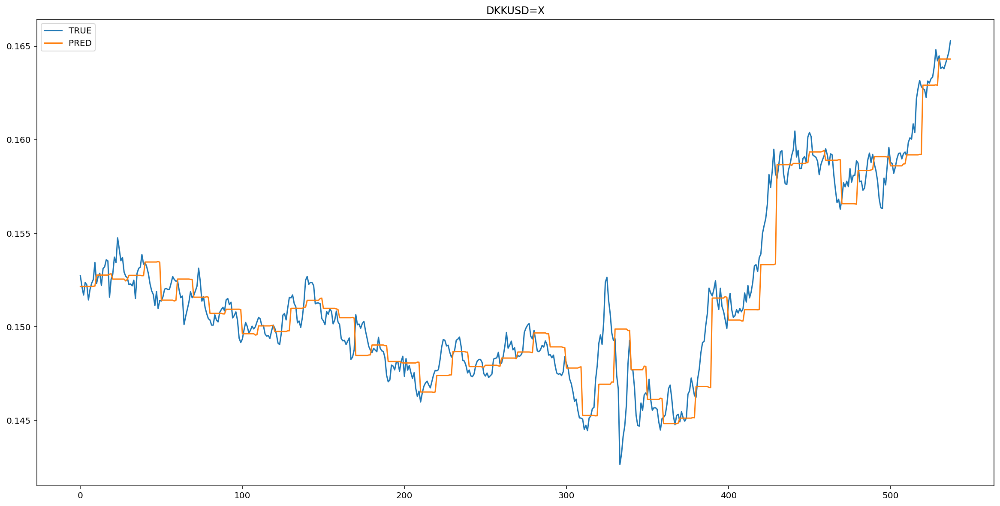

...

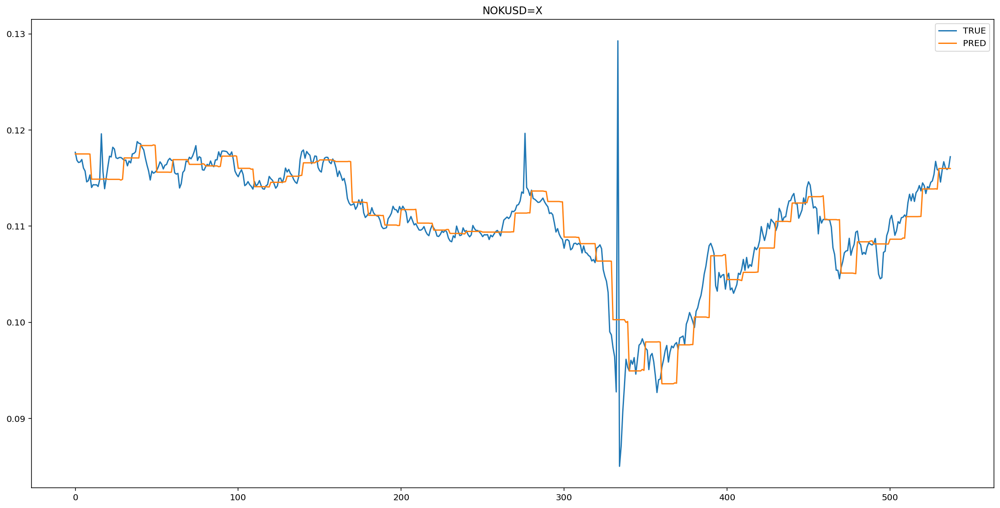

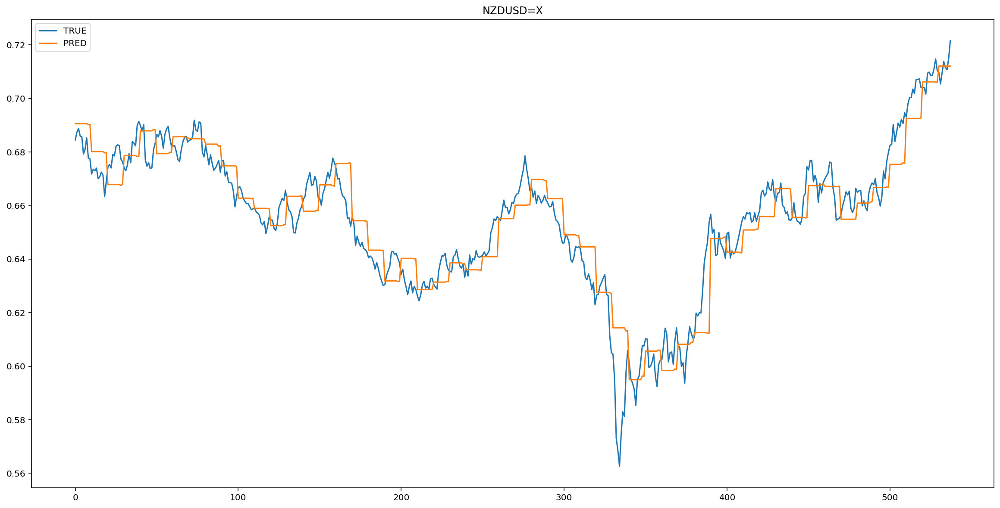

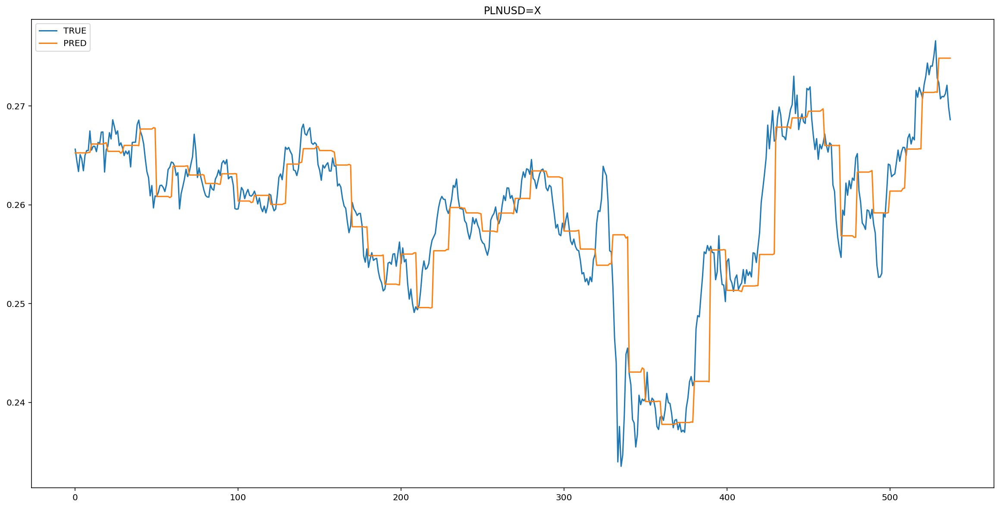

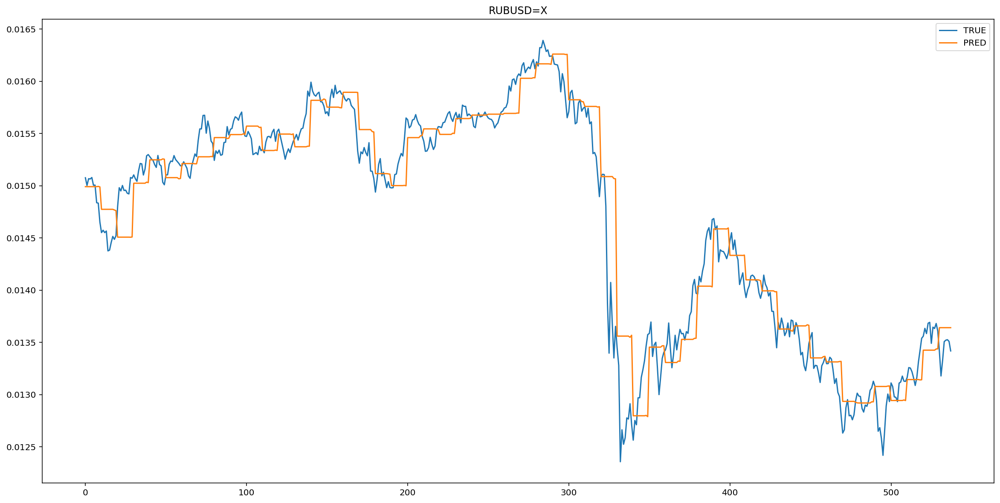

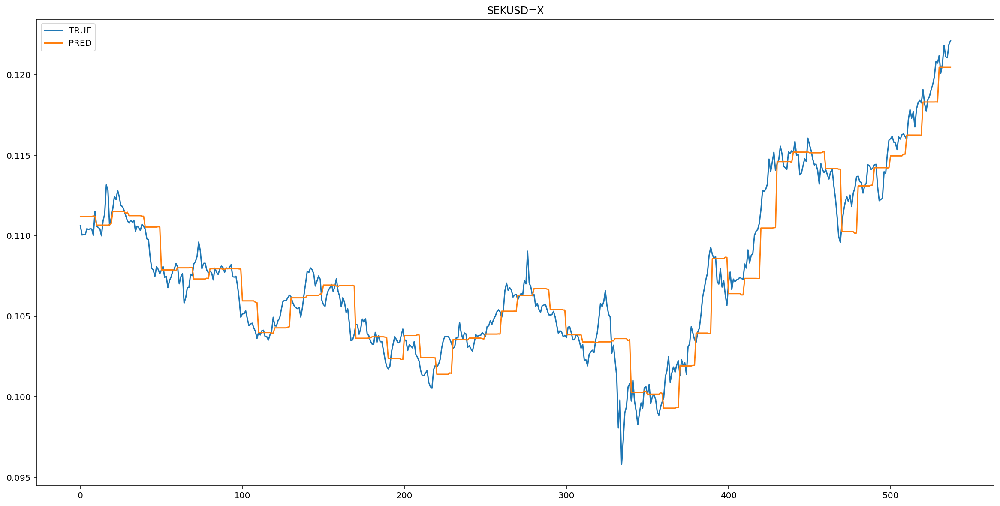

In [ ]:
for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

##Регрессия

Импортируем библиотеки

In [ ]:
from sklearn.linear_model import Ridge, Lasso

###Простая линейная

Строим модель

In [ ]:
linear_model = LinearRegression()
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Считаем score

In [ ]:
 linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.6/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9363978633350876

###Lasso

Строим модель

In [ ]:
linear_model = Lasso(alpha=0.0001)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Считаем score

In [ ]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.6/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9718235767925191

###Ridge

Строим модель

In [ ]:
linear_model = Ridge(alpha=0.004)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Считаем score

In [ ]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.6/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9379977471301194

##ARIMA

###ARIMA

###SARIMAX

###VAR

In [ ]:
from statsmodels.tsa.api import VAR 

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
model = VAR(train_y)

In [ ]:
results = model.fit(ic='aic') 

In [ ]:
y_pred = []

for i in range(len(test_X)):
  y_pred.append(results.forecast(test_X[i], 1)[0])
y_pred = scaler.inverse_transform(np.array(y_pred))
y_hat = scaler.inverse_transform(test_y)

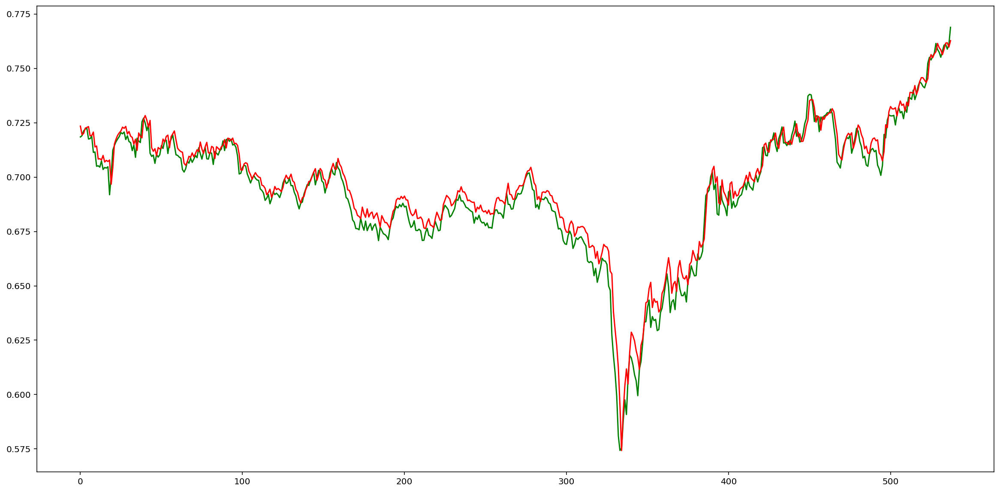

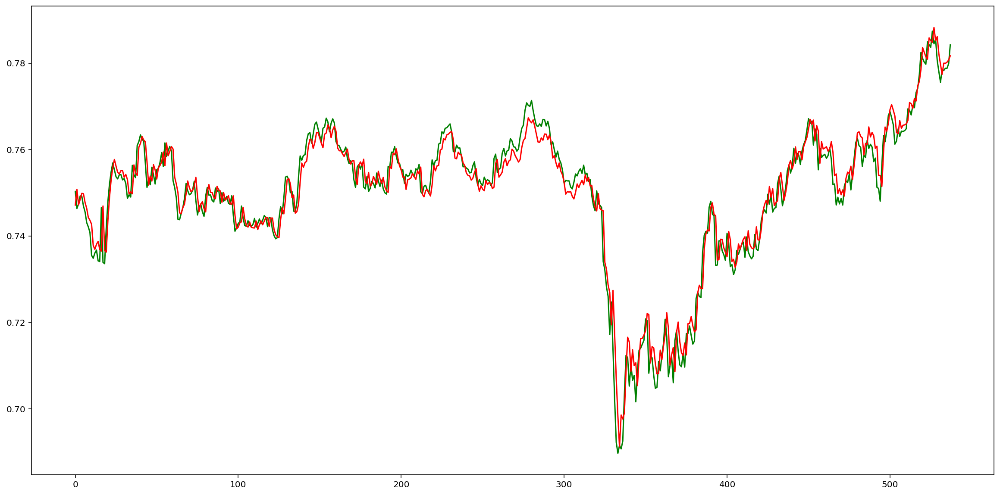

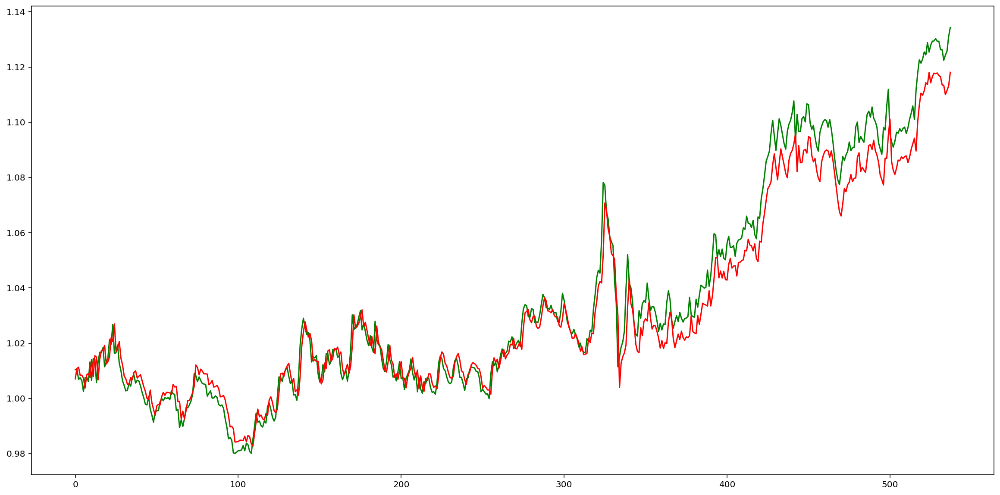

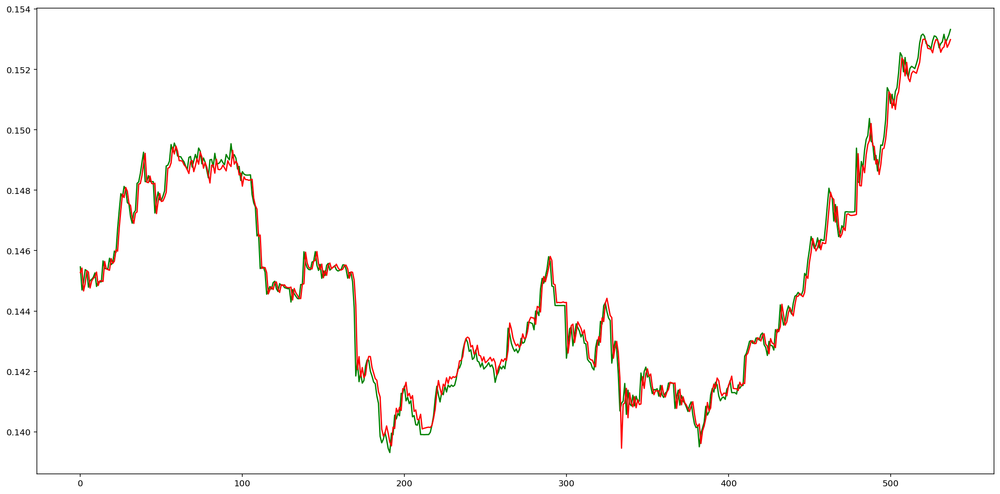

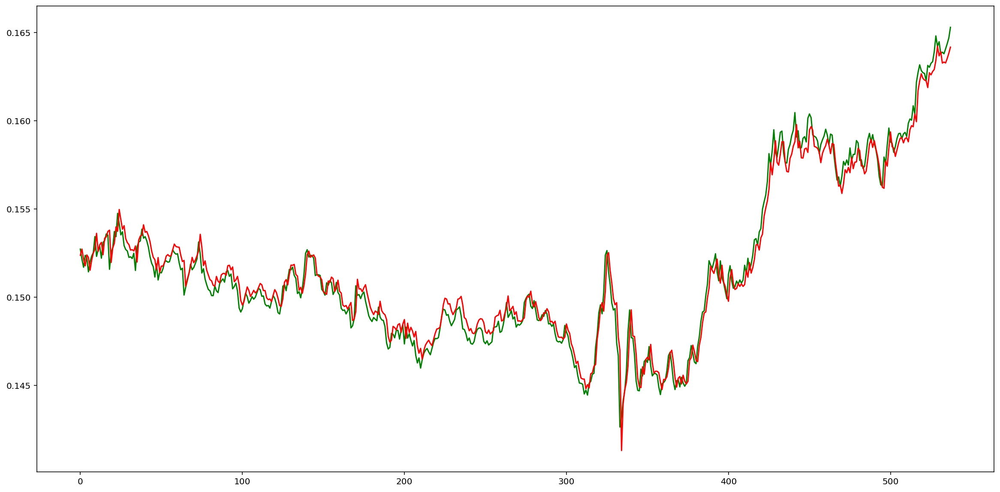

...

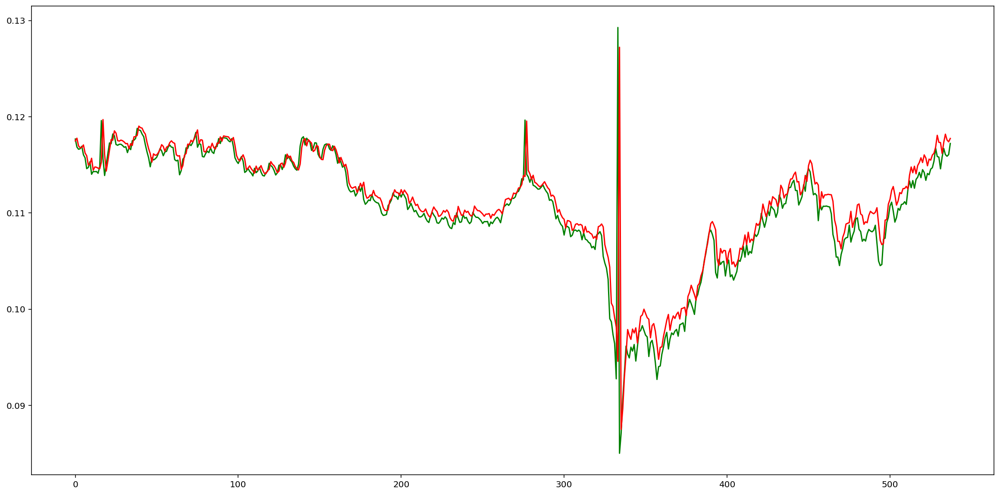

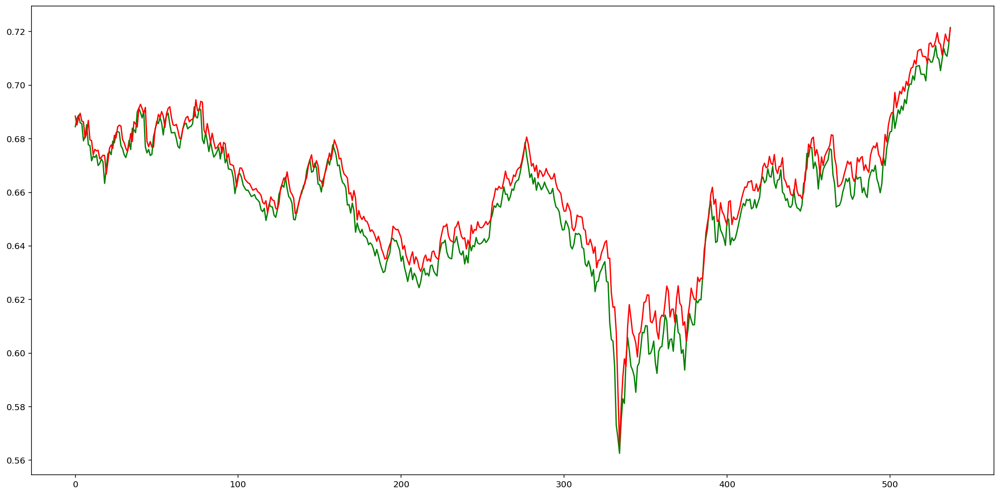

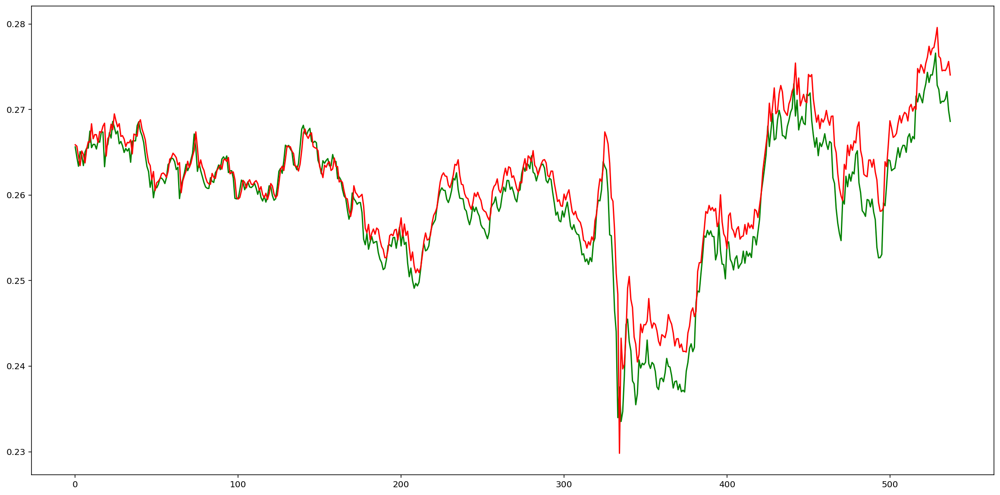

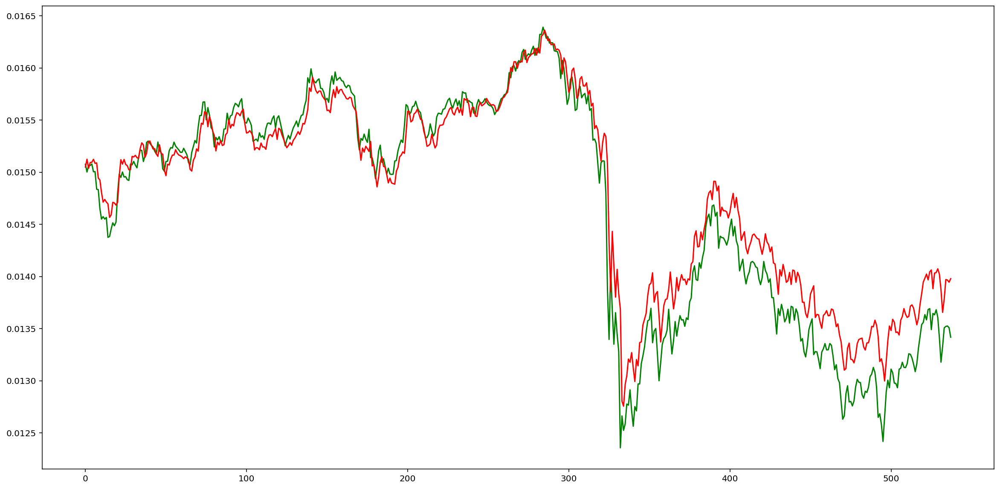

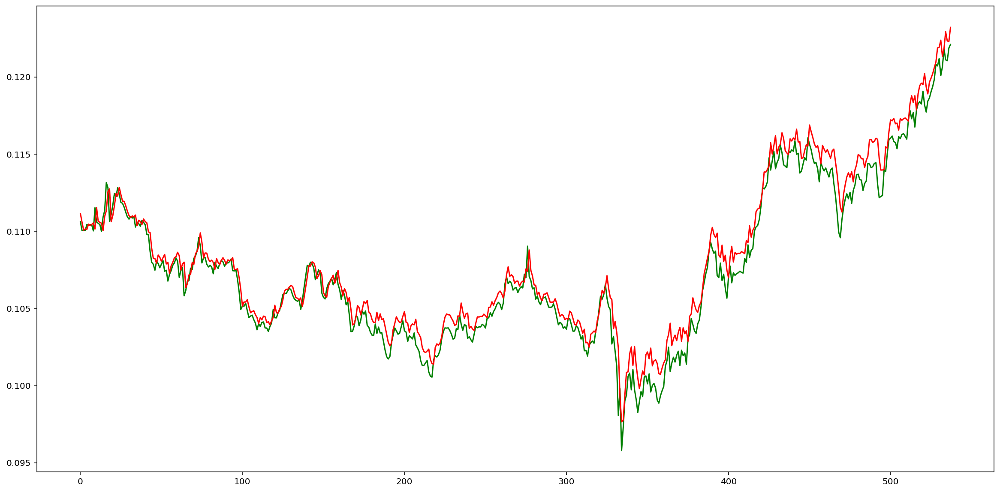

In [ ]:
for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.plot(y_hat[:, i], color='green')
    plt.plot(y_pred[:, i], color='red')

Оцениваем точность

###VARIMAX

##Нейронные сети

###Перцептрон

In [ ]:
 # design network
model = Sequential()
model.add(Dense(128, input_shape=(train_X.shape[1], train_X.shape[2]), activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Flatten())
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 2s - loss: 0.3696 - val_loss: 0.1554
Epoch 2/100
4/4 - 0s - loss: 0.1592 - val_loss: 0.0790
Epoch 3/100
4/4 - 0s - loss: 0.0515 - val_loss: 0.0608
Epoch 4/100
4/4 - 0s - loss: 0.0360 - val_loss: 0.0617
Epoch 5/100
4/4 - 0s - loss: 0.0337 - val_loss: 0.0510
Epoch 6/100
4/4 - 0s - loss: 0.0238 - val_loss: 0.0458
Epoch 7/100
4/4 - 0s - loss: 0.0222 - val_loss: 0.0445
Epoch 8/100
4/4 - 0s - loss: 0.0199 - val_loss: 0.0433
Epoch 9/100
4/4 - 0s - loss: 0.0153 - val_loss: 0.0431
Epoch 10/100
4/4 - 0s - loss: 0.0125 - val_loss: 0.0441
Epoch 11/100
4/4 - 0s - loss: 0.0111 - val_loss: 0.0447
Epoch 12/100
4/4 - 0s - loss: 0.0099 - val_loss: 0.0445
Epoch 13/100
4/4 - 0s - loss: 0.0087 - val_loss: 0.0440
Epoch 14/100
4/4 - 0s - loss: 0.0078 - val_loss: 0.0433
Epoch 15/100
4/4 - 0s - loss: 0.0072 - val_loss: 0.0428
Epoch 16/100
4/4 - 0s - loss: 0.0067 - val_loss: 0.0423
Epoch 17/100
4/4 - 0s - loss: 0.0063 - val_loss: 0.0423
Epoch 18/100
4/4 - 0s - loss: 0.0059 - val_loss: 0.0424
E

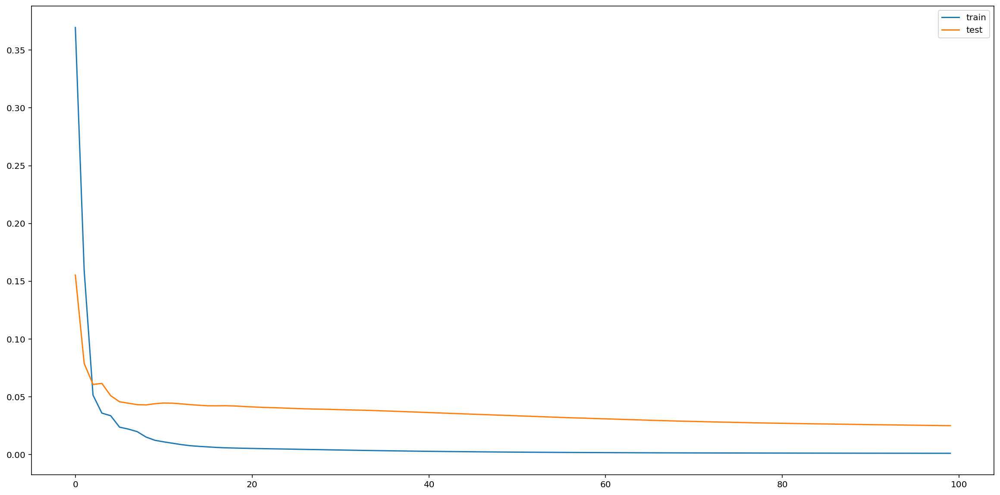

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

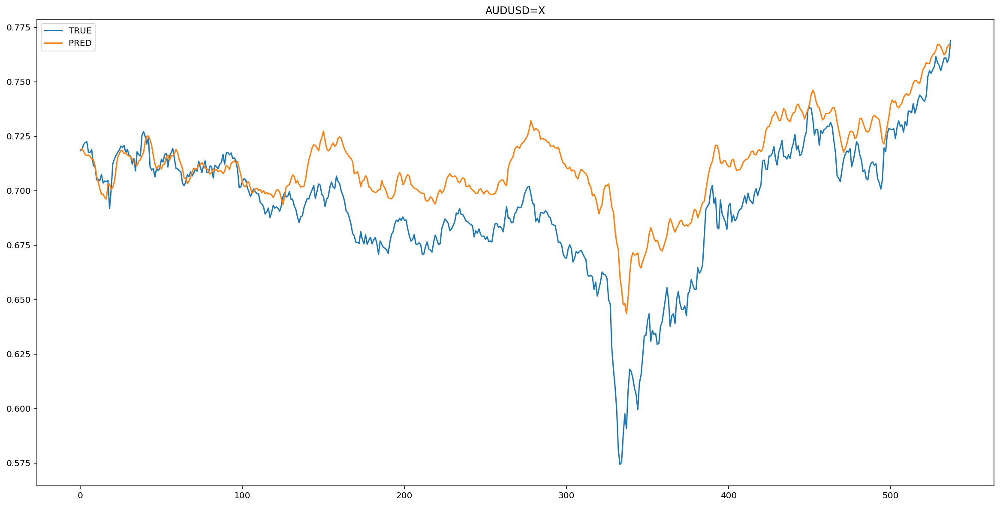

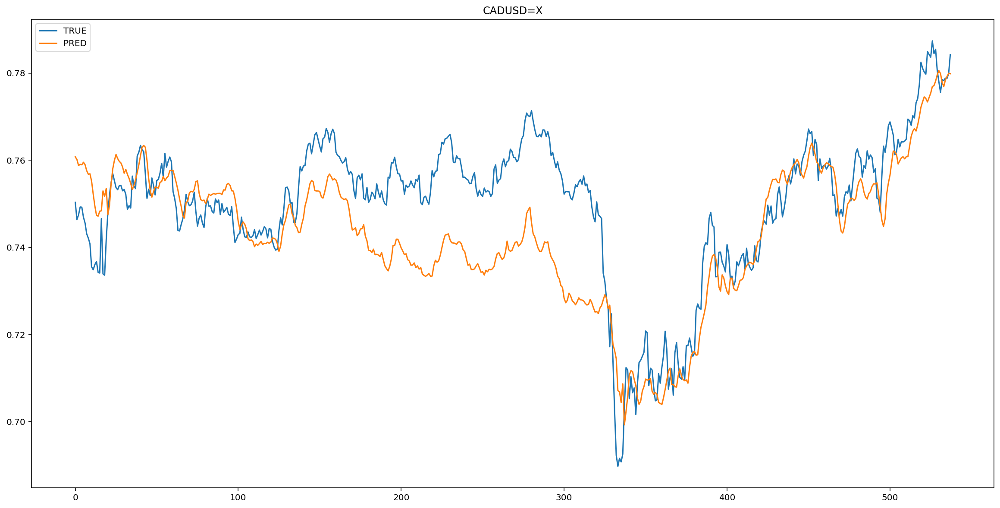

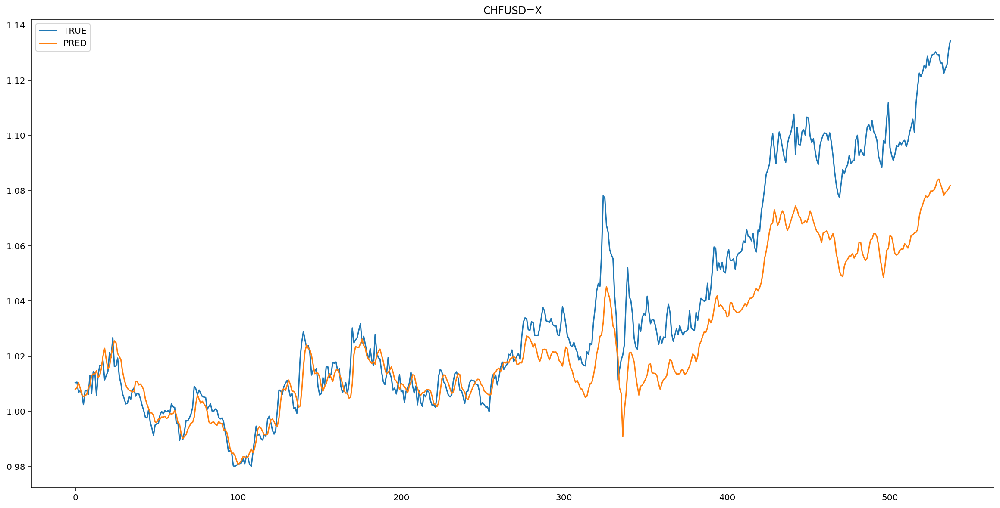

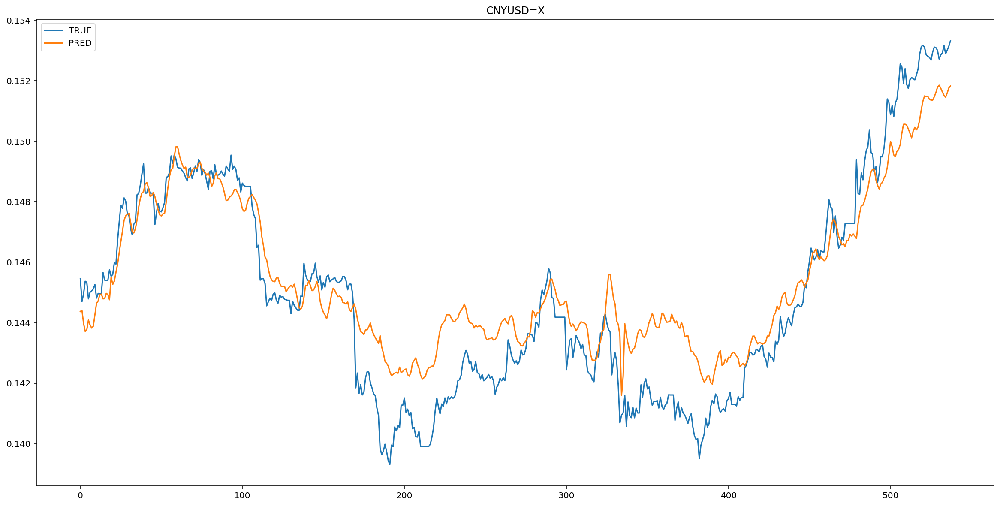

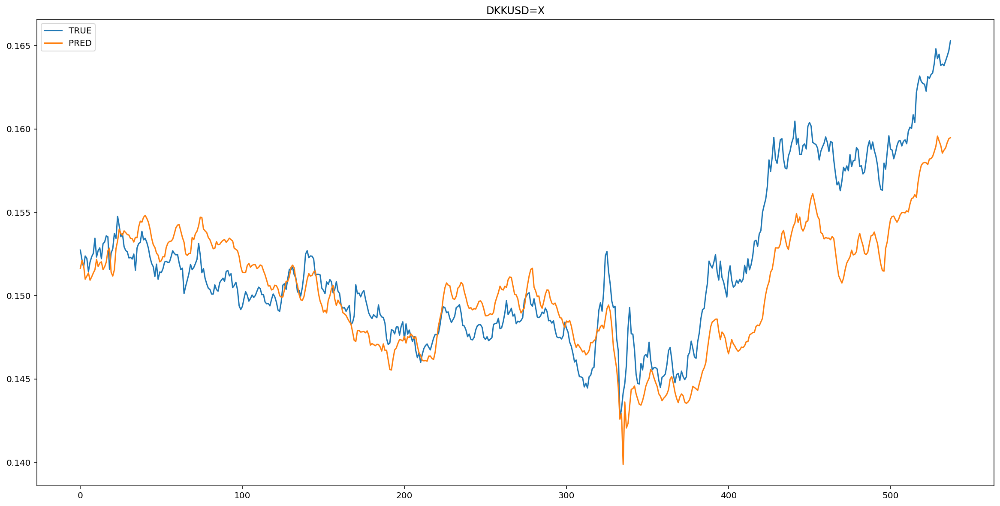

...

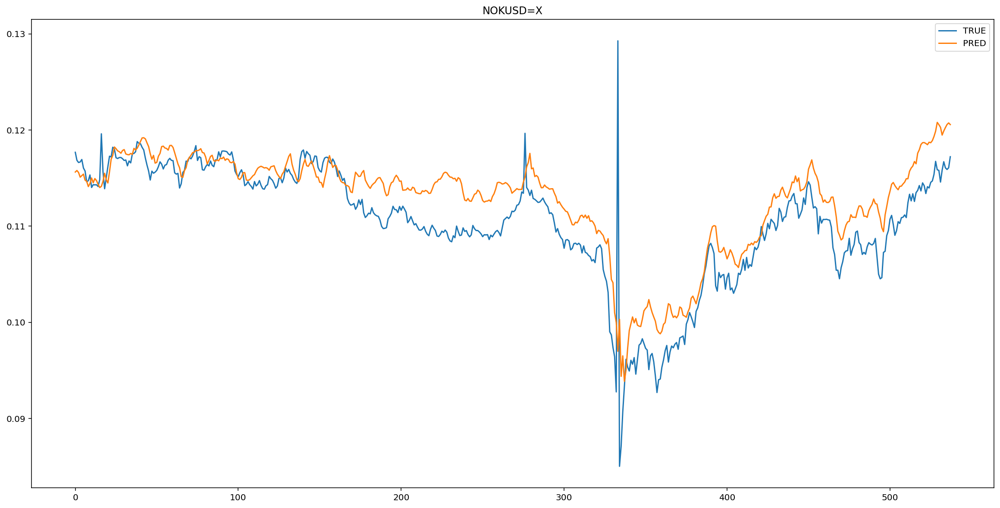

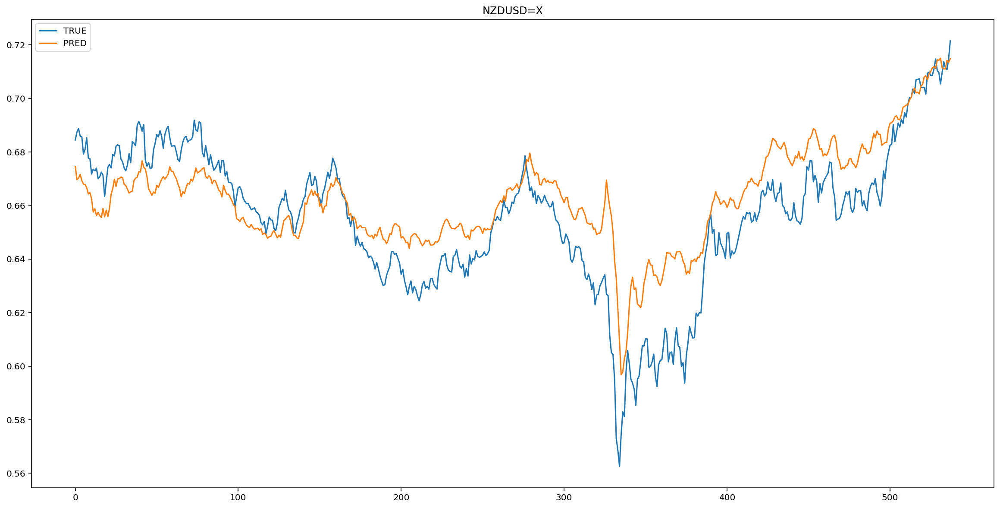

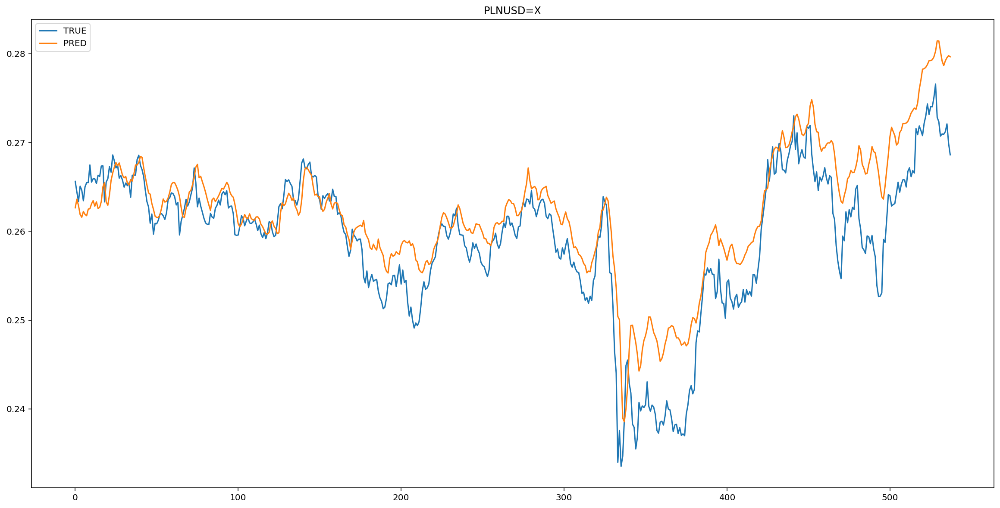

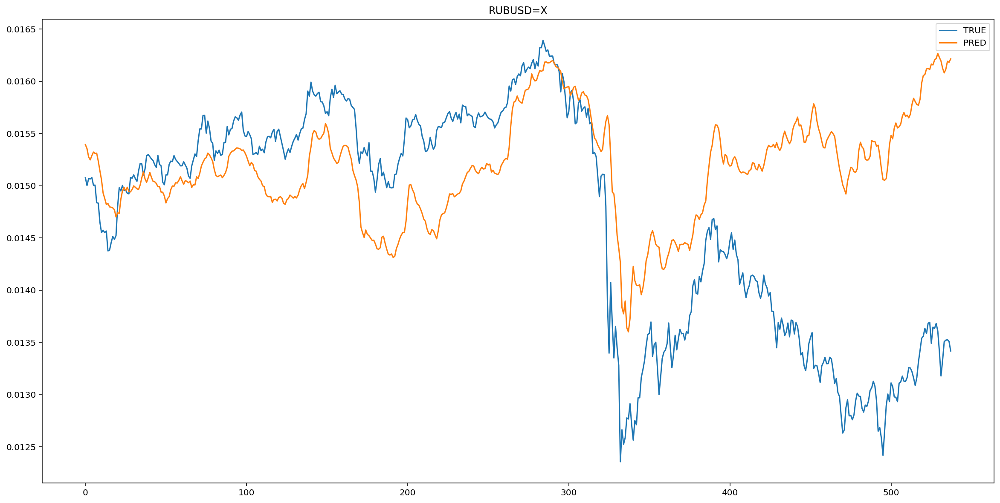

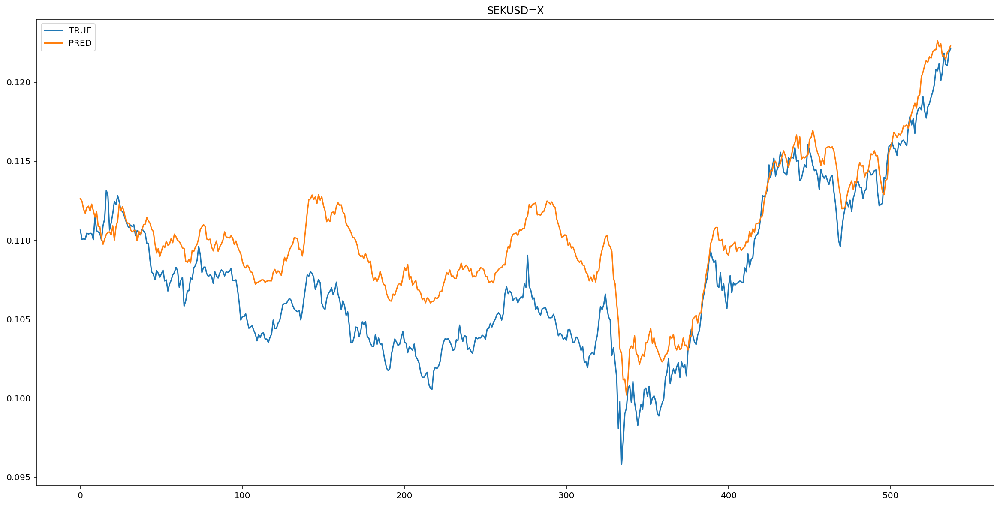

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

###Свёрточные

In [ ]:
 # design network

model = Sequential()
model.add(Conv2D(128, (2,2) ,input_shape=(train_X.shape[1], train_X.shape[2], 1), activation='relu'))

model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(train_y.shape[1],activation='relu'))

model.compile(loss='mse', optimizer='adam')

In [ ]:
 train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1).shape

(500, 3, 15, 1)

Epoch 1/100
4/4 - 6s - loss: 0.3347 - val_loss: 0.1583
Epoch 2/100
4/4 - 0s - loss: 0.2379 - val_loss: 0.1090
Epoch 3/100
4/4 - 0s - loss: 0.1948 - val_loss: 0.1031
Epoch 4/100
4/4 - 0s - loss: 0.1894 - val_loss: 0.1121
Epoch 5/100
4/4 - 0s - loss: 0.1715 - val_loss: 0.1091
Epoch 6/100
4/4 - 0s - loss: 0.1577 - val_loss: 0.1006
Epoch 7/100
4/4 - 0s - loss: 0.1459 - val_loss: 0.0916
Epoch 8/100
4/4 - 0s - loss: 0.1350 - val_loss: 0.0807
Epoch 9/100
4/4 - 0s - loss: 0.1294 - val_loss: 0.0720
Epoch 10/100
4/4 - 0s - loss: 0.1220 - val_loss: 0.0671
Epoch 11/100
4/4 - 0s - loss: 0.1151 - val_loss: 0.0640
Epoch 12/100
4/4 - 0s - loss: 0.1149 - val_loss: 0.0629
Epoch 13/100
4/4 - 0s - loss: 0.1108 - val_loss: 0.0623
Epoch 14/100
4/4 - 0s - loss: 0.1054 - val_loss: 0.0613
Epoch 15/100
4/4 - 0s - loss: 0.1028 - val_loss: 0.0602
Epoch 16/100
4/4 - 0s - loss: 0.0966 - val_loss: 0.0586
Epoch 17/100
4/4 - 0s - loss: 0.0941 - val_loss: 0.0568
Epoch 18/100
4/4 - 0s - loss: 0.0900 - val_loss: 0.0551
E

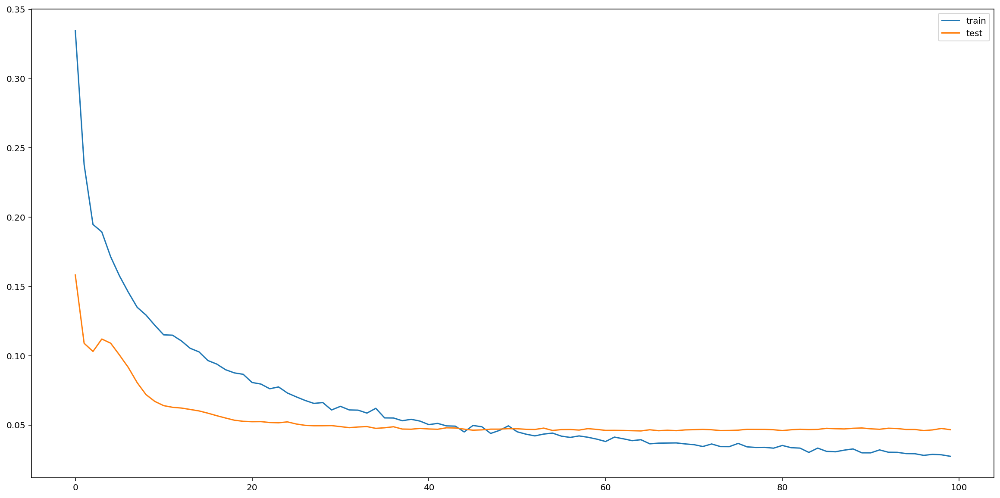

In [ ]:
 # fit network
#history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
#y_pred = scaler.inverse_transform(model.predict(test_X))
y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

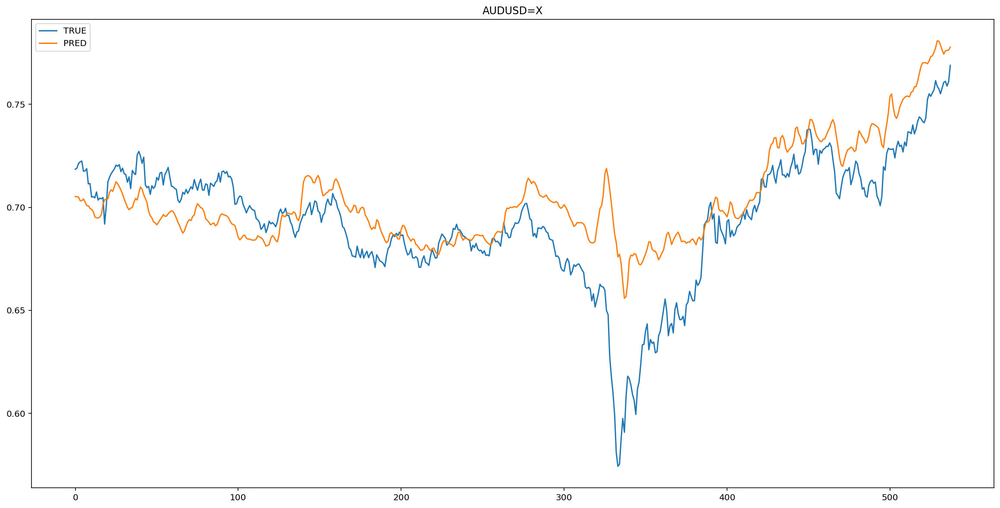

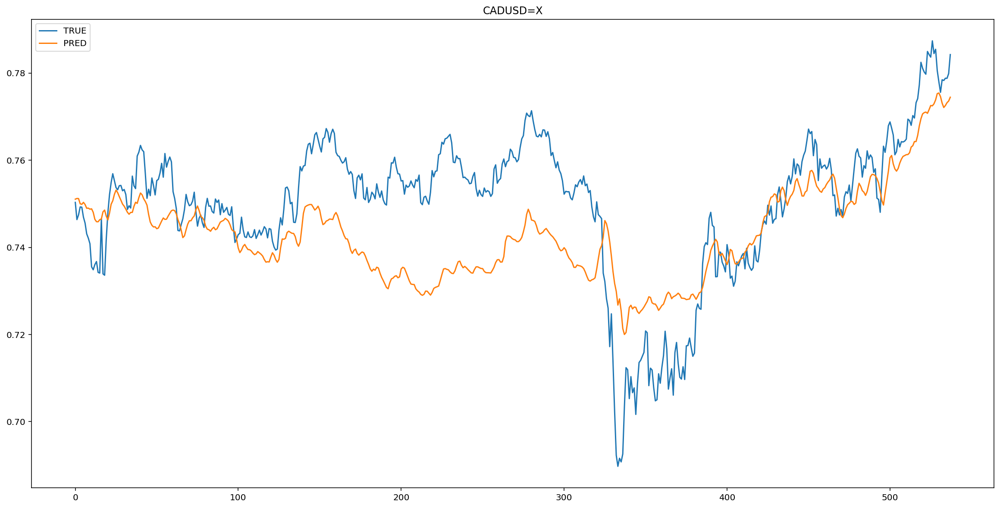

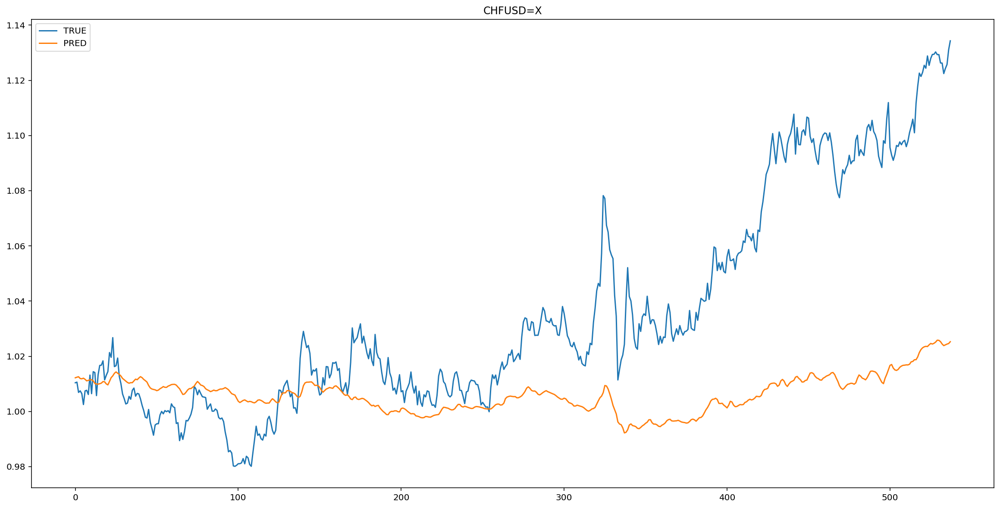

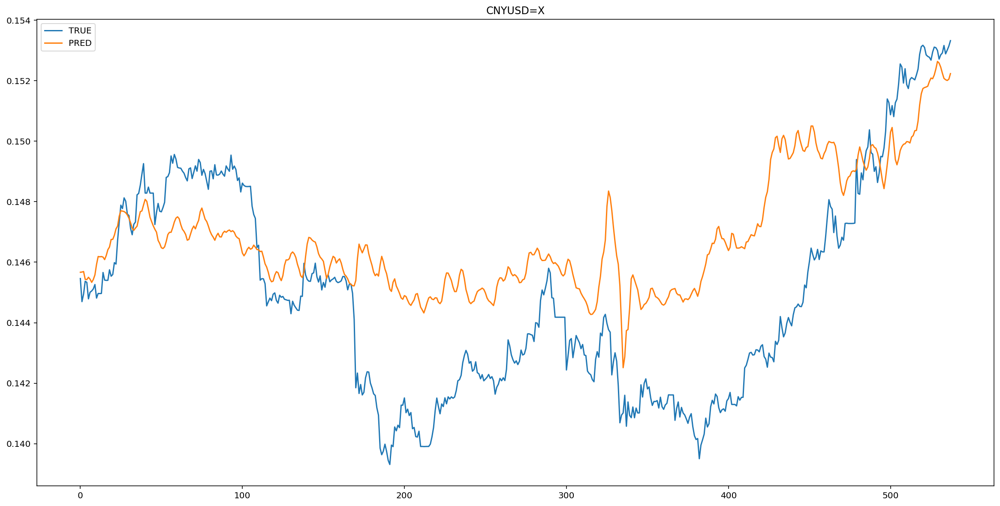

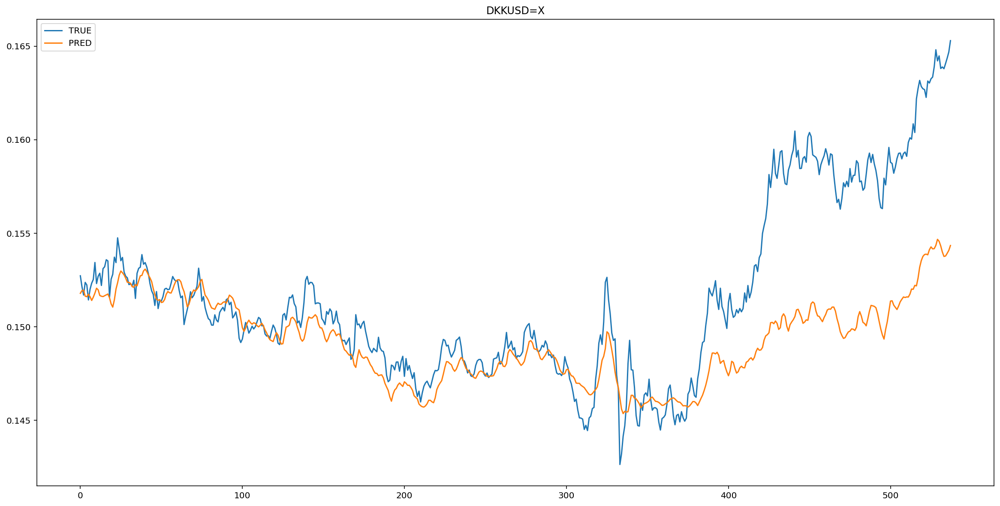

...

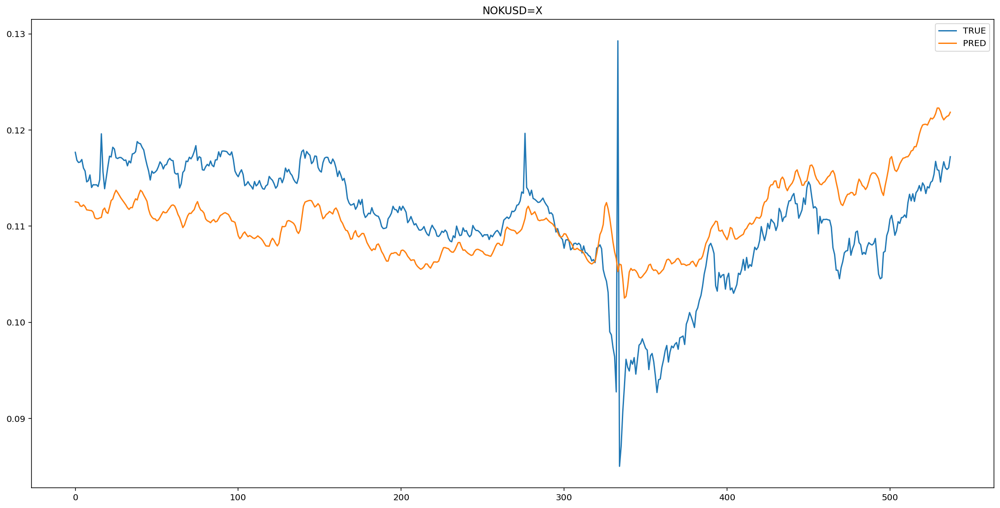

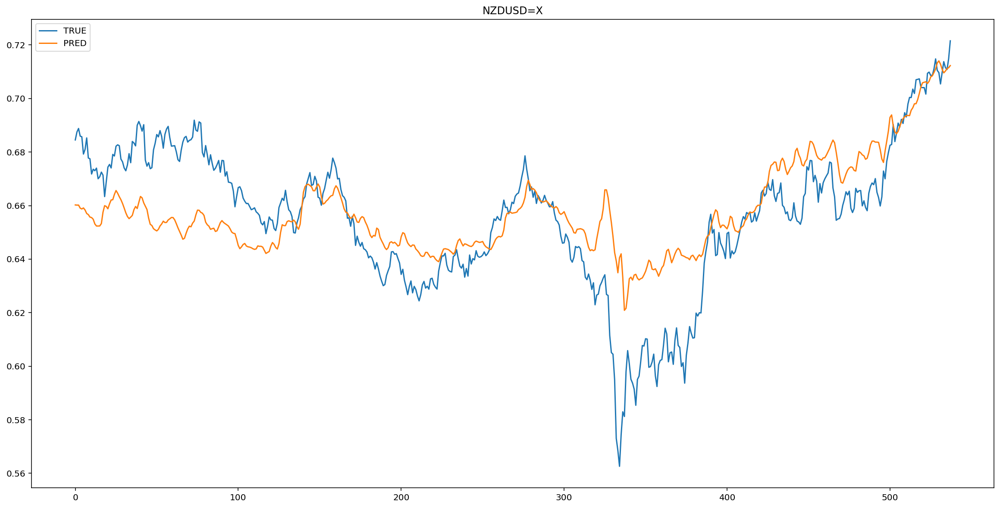

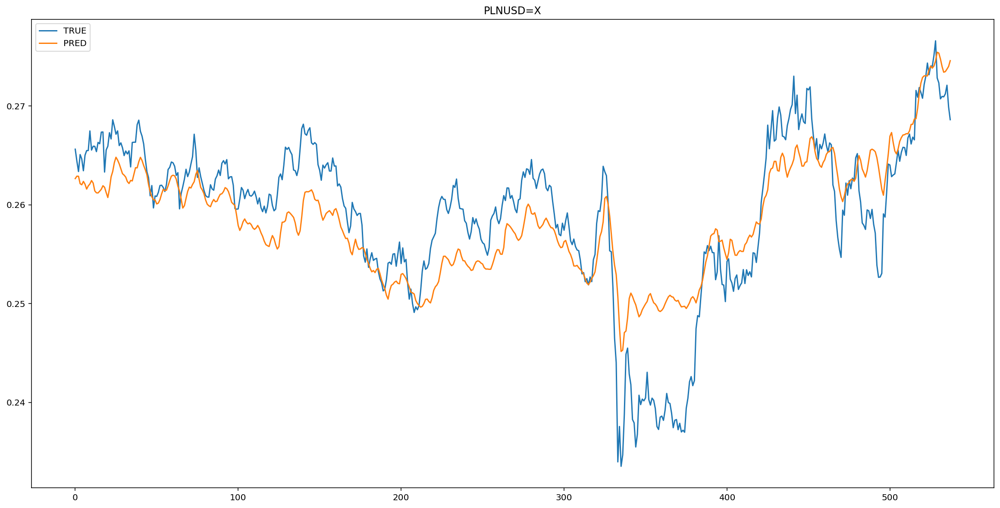

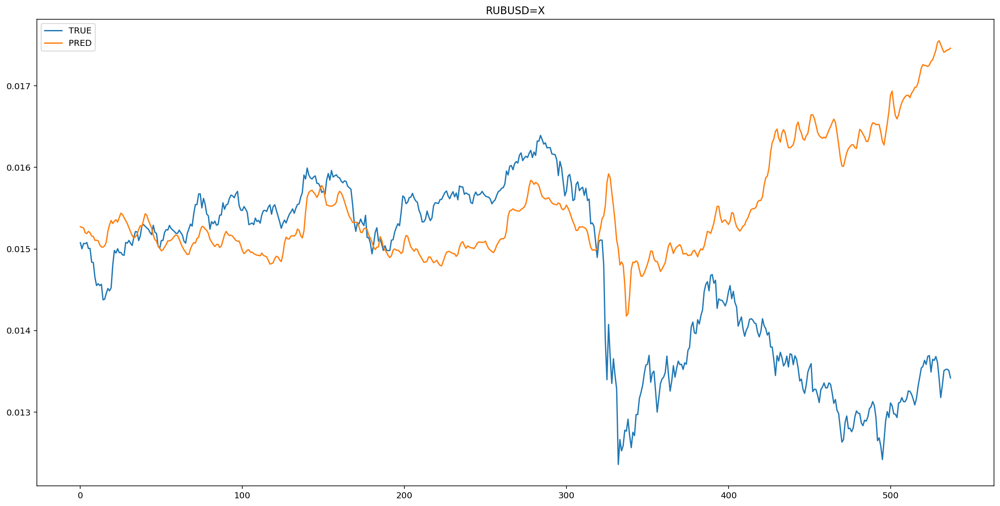

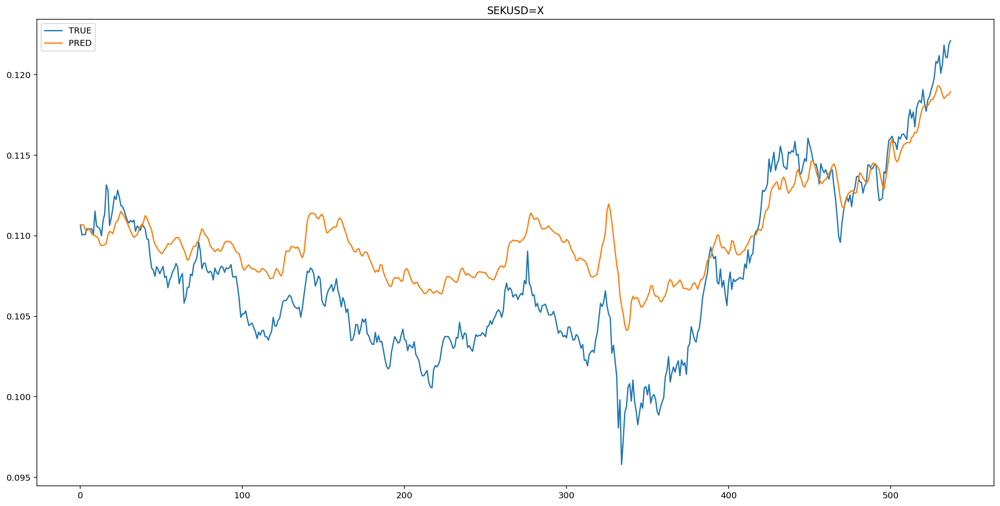

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

###Рекуррентные

####RNN

In [ ]:
# design network
model = Sequential()
model.add(SimpleRNN(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(SimpleRNN(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 1s - loss: 0.4030 - val_loss: 0.0934
Epoch 2/100
4/4 - 0s - loss: 0.1012 - val_loss: 0.0552
Epoch 3/100
4/4 - 0s - loss: 0.0481 - val_loss: 0.0632
Epoch 4/100
4/4 - 0s - loss: 0.0293 - val_loss: 0.0711
Epoch 5/100
4/4 - 0s - loss: 0.0241 - val_loss: 0.0729
Epoch 6/100
4/4 - 0s - loss: 0.0214 - val_loss: 0.0631
Epoch 7/100
4/4 - 0s - loss: 0.0145 - val_loss: 0.0534
Epoch 8/100
4/4 - 0s - loss: 0.0118 - val_loss: 0.0497
Epoch 9/100
4/4 - 0s - loss: 0.0104 - val_loss: 0.0515
Epoch 10/100
4/4 - 0s - loss: 0.0089 - val_loss: 0.0533
Epoch 11/100
4/4 - 0s - loss: 0.0078 - val_loss: 0.0525
Epoch 12/100
4/4 - 0s - loss: 0.0072 - val_loss: 0.0509
Epoch 13/100
4/4 - 0s - loss: 0.0064 - val_loss: 0.0498
Epoch 14/100
4/4 - 0s - loss: 0.0061 - val_loss: 0.0492
Epoch 15/100
4/4 - 0s - loss: 0.0059 - val_loss: 0.0487
Epoch 16/100
4/4 - 0s - loss: 0.0055 - val_loss: 0.0488
Epoch 17/100
4/4 - 0s - loss: 0.0052 - val_loss: 0.0488
Epoch 18/100
4/4 - 0s - loss: 0.0050 - val_loss: 0.0482
E

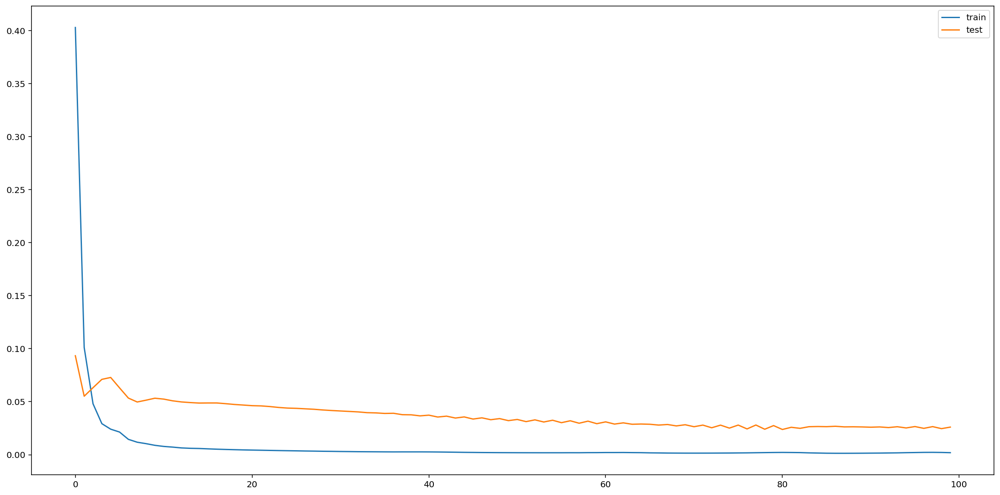

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

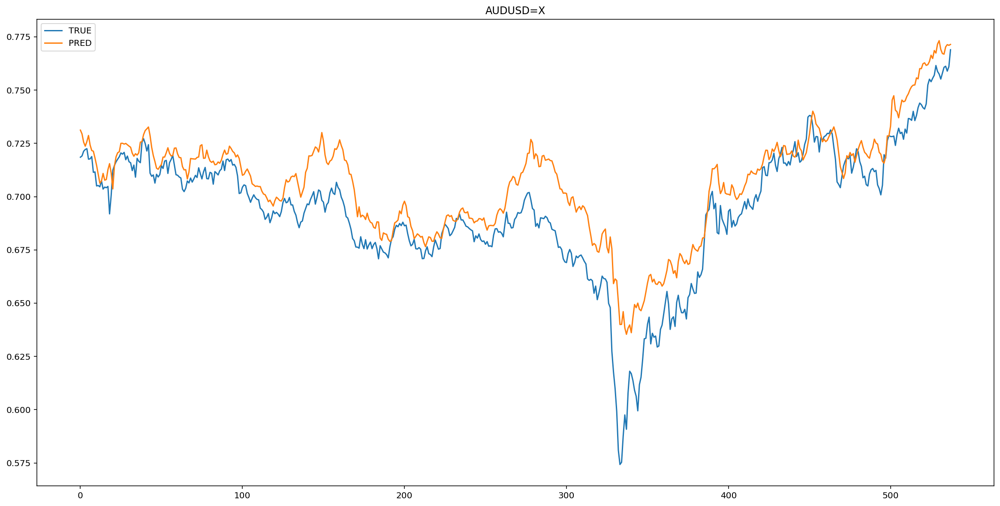

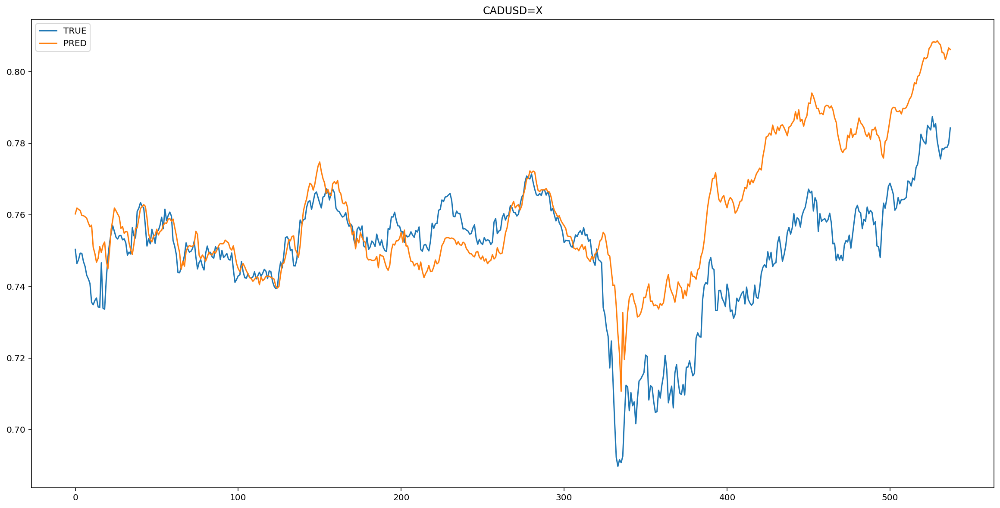

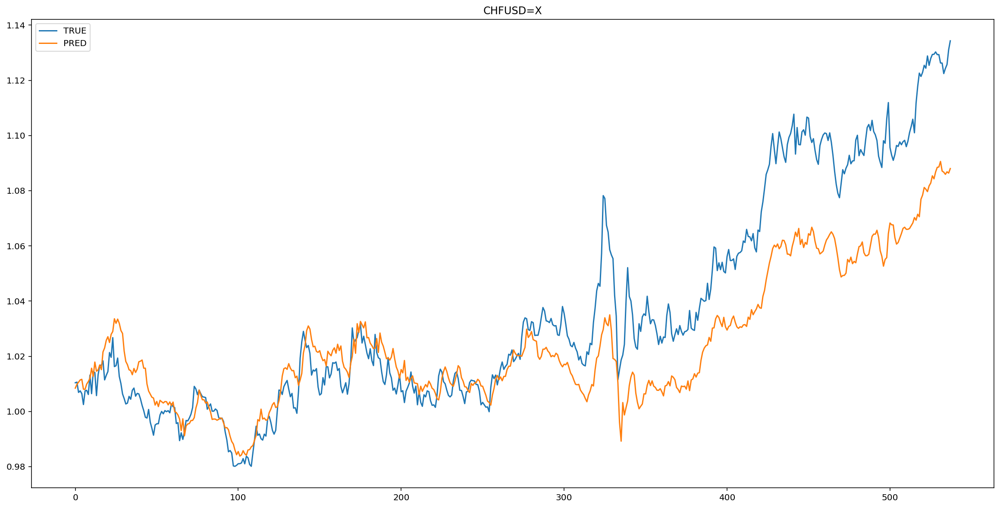

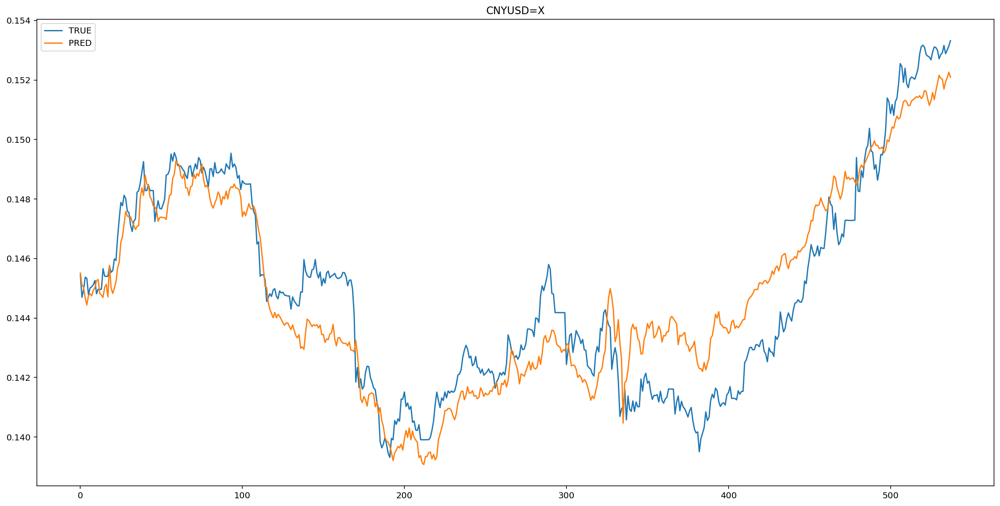

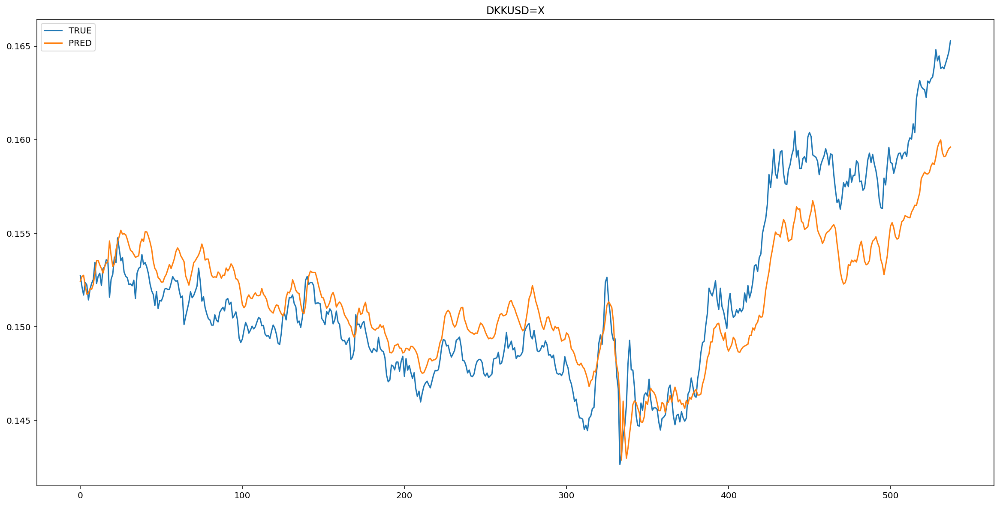

...

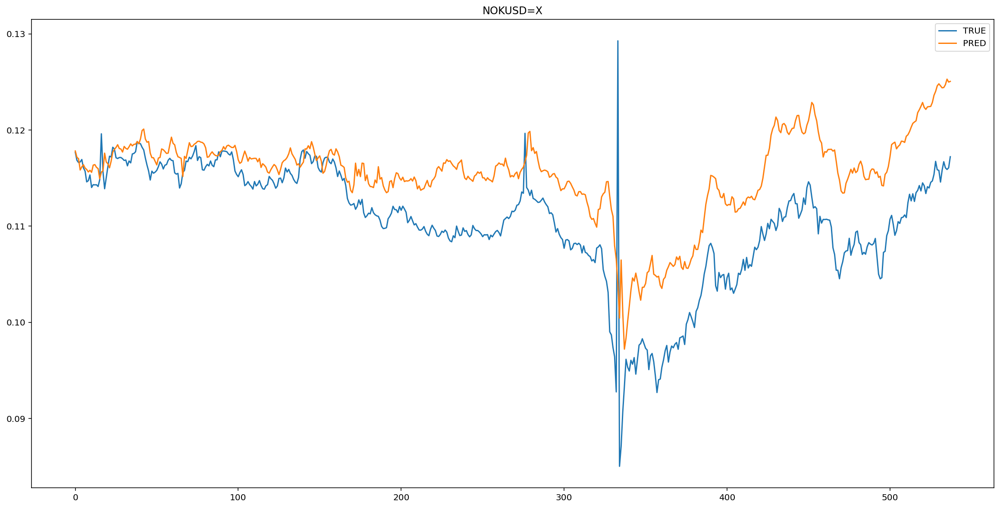

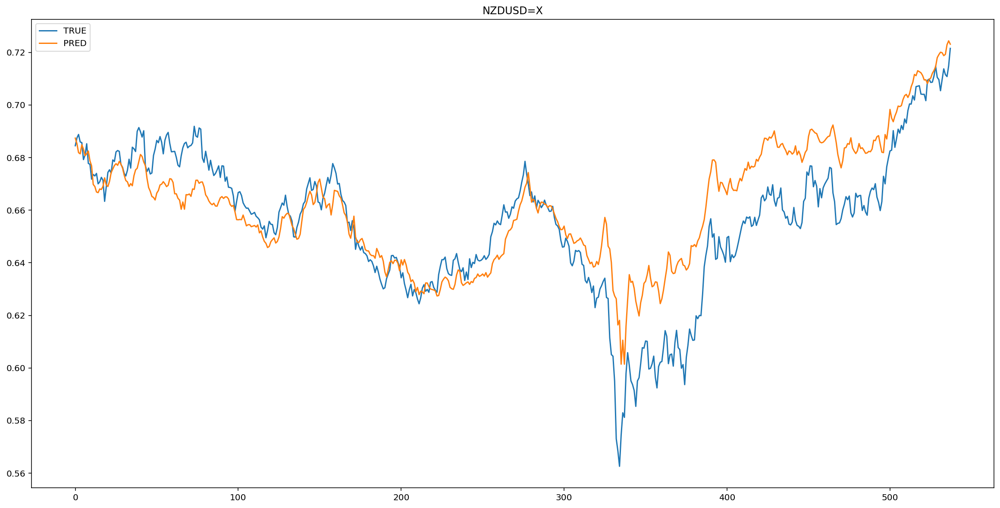

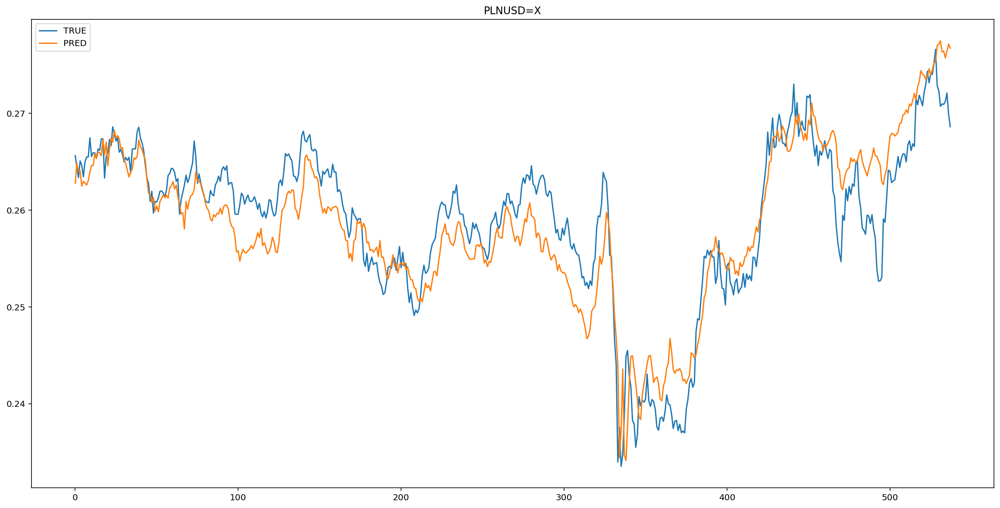

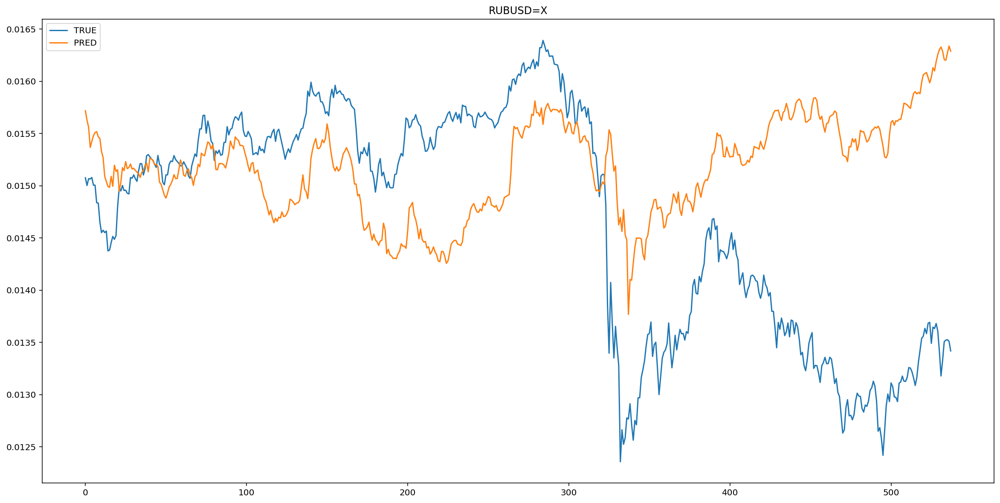

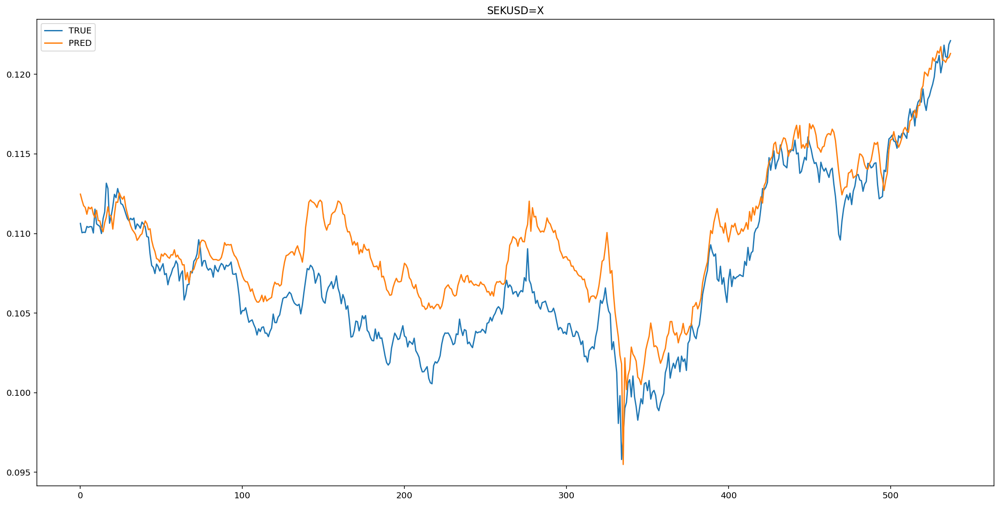

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####LSTM

In [ ]:
# design network
model = Sequential()
model.add(LSTM(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(LSTM(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 2s - loss: 0.4005 - val_loss: 0.2187
Epoch 2/100
4/4 - 0s - loss: 0.3634 - val_loss: 0.1968
Epoch 3/100
4/4 - 0s - loss: 0.3140 - val_loss: 0.1649
Epoch 4/100
4/4 - 0s - loss: 0.2373 - val_loss: 0.1187
Epoch 5/100
4/4 - 0s - loss: 0.1311 - val_loss: 0.0676
Epoch 6/100
4/4 - 0s - loss: 0.0838 - val_loss: 0.0549
Epoch 7/100
4/4 - 0s - loss: 0.0668 - val_loss: 0.0511
Epoch 8/100
4/4 - 0s - loss: 0.0329 - val_loss: 0.0555
Epoch 9/100
4/4 - 0s - loss: 0.0315 - val_loss: 0.0563
Epoch 10/100
4/4 - 0s - loss: 0.0273 - val_loss: 0.0528
Epoch 11/100
4/4 - 0s - loss: 0.0241 - val_loss: 0.0508
Epoch 12/100
4/4 - 0s - loss: 0.0256 - val_loss: 0.0500
Epoch 13/100
4/4 - 0s - loss: 0.0232 - val_loss: 0.0502
Epoch 14/100
4/4 - 0s - loss: 0.0226 - val_loss: 0.0500
Epoch 15/100
4/4 - 0s - loss: 0.0222 - val_loss: 0.0485
Epoch 16/100
4/4 - 0s - loss: 0.0212 - val_loss: 0.0473
Epoch 17/100
4/4 - 0s - loss: 0.0211 - val_loss: 0.0472
Epoch 18/100
4/4 - 0s - loss: 0.0206 - val_loss: 0.0476
E

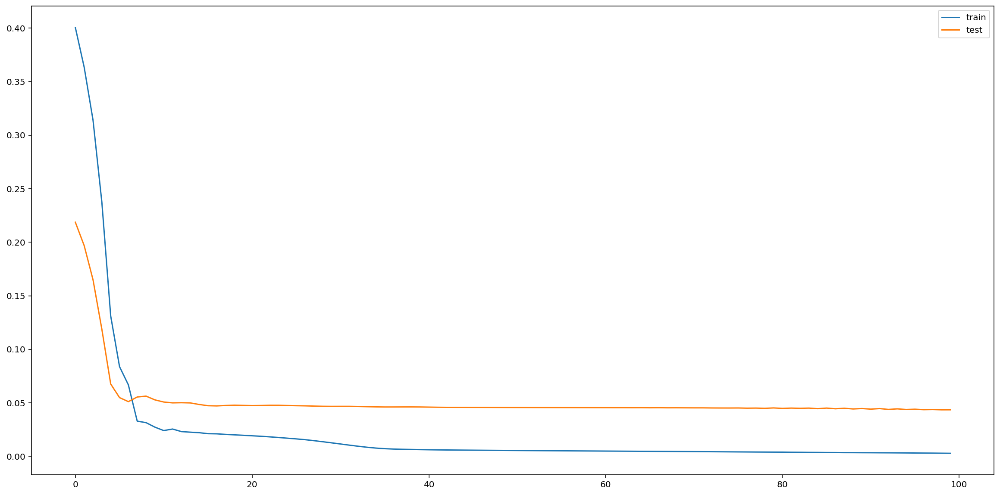

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

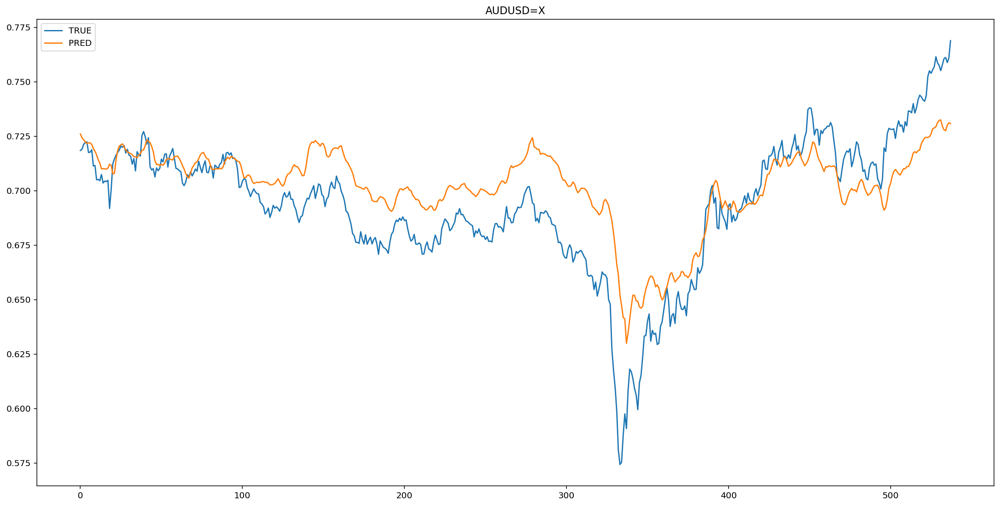

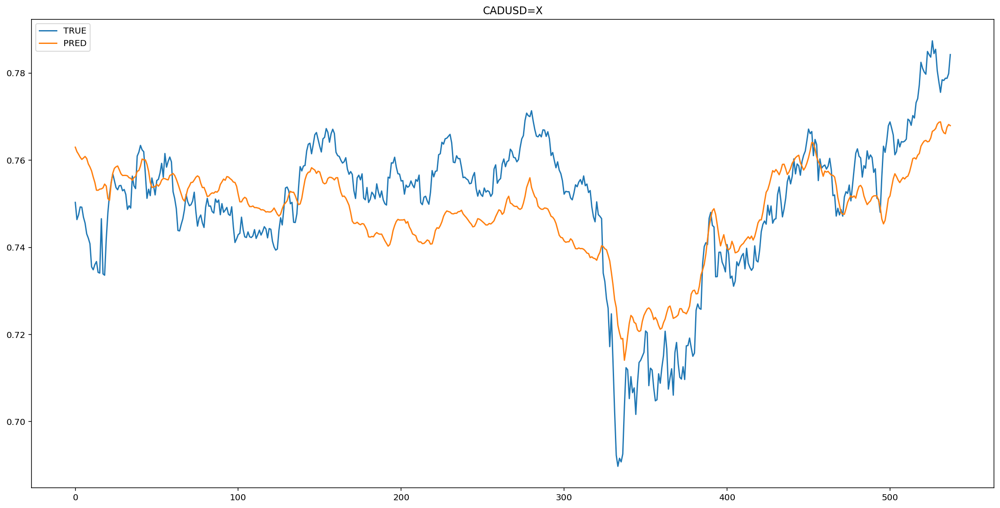

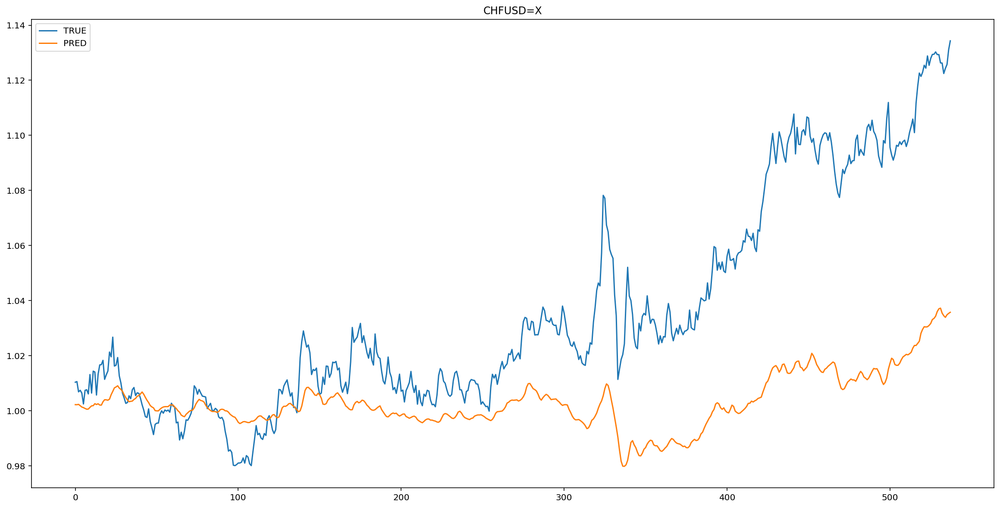

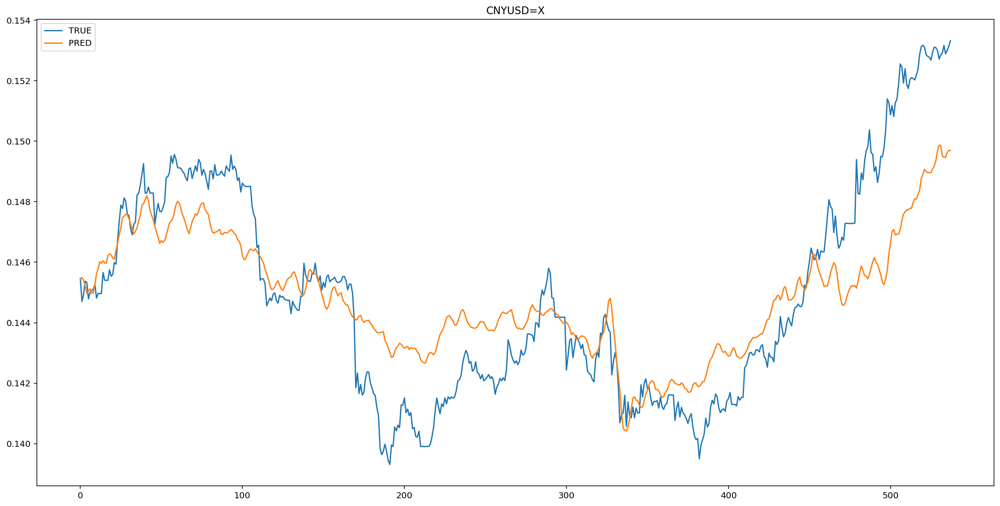

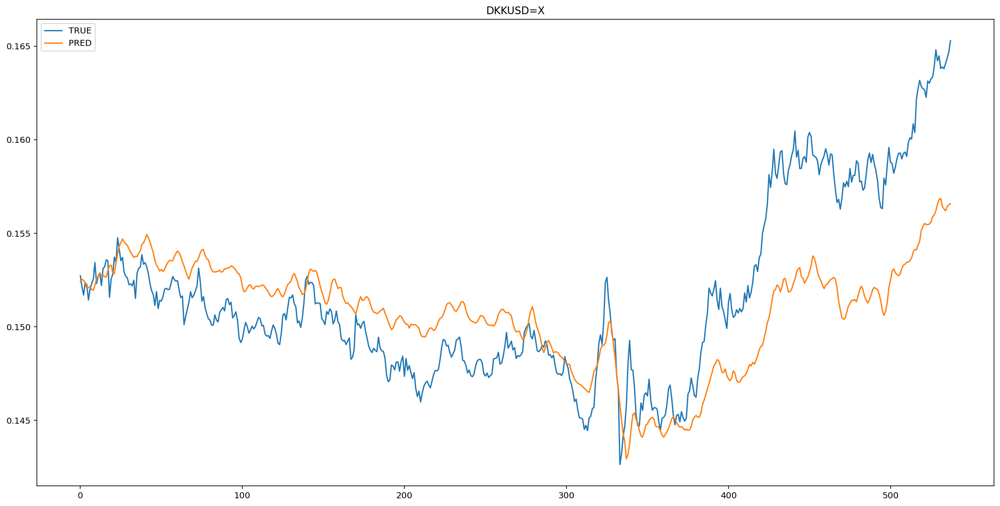

...

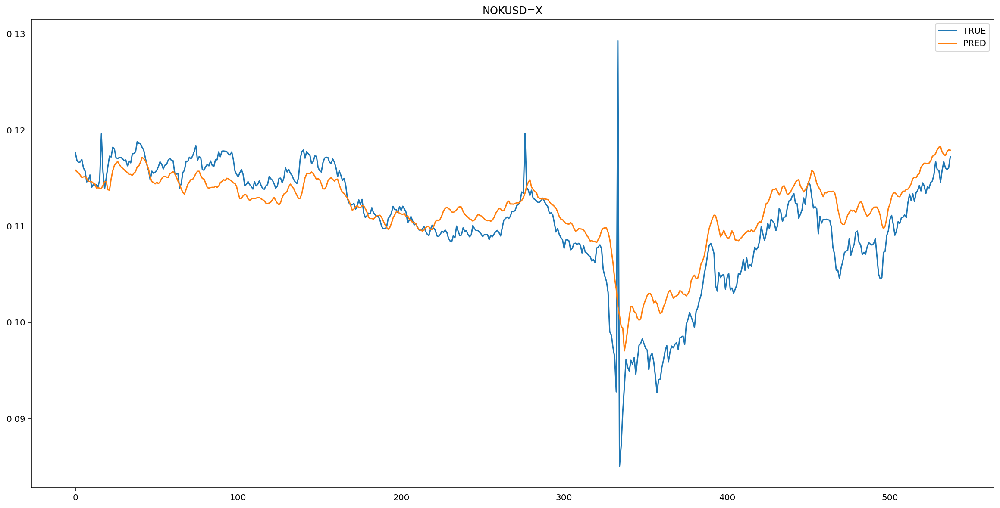

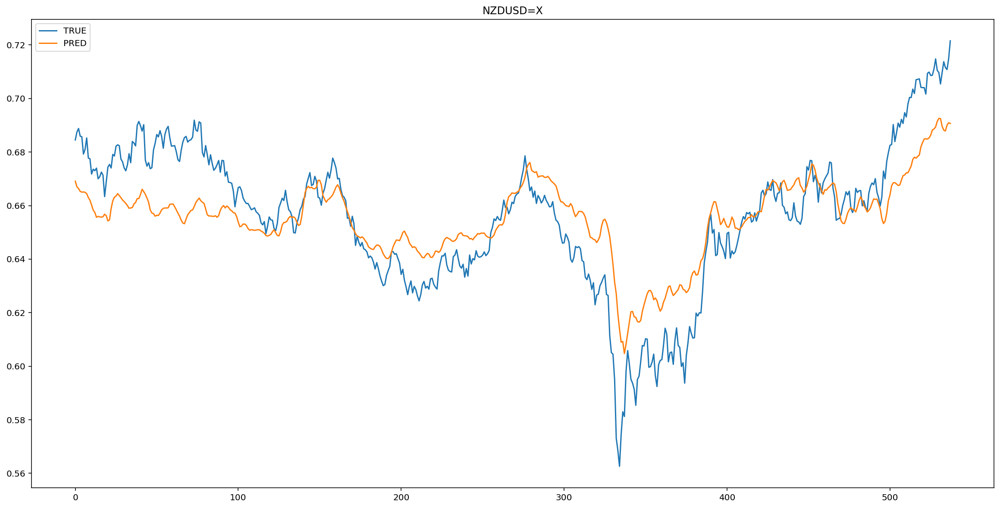

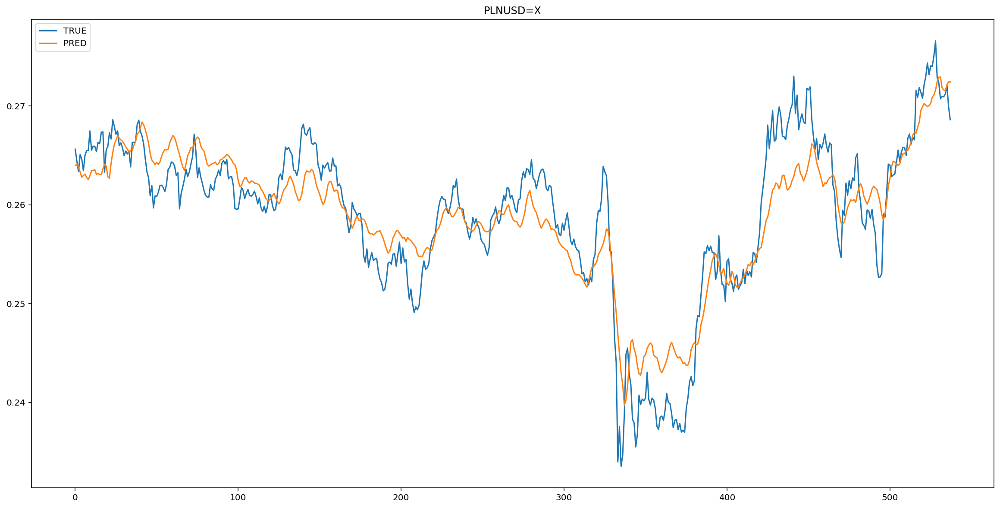

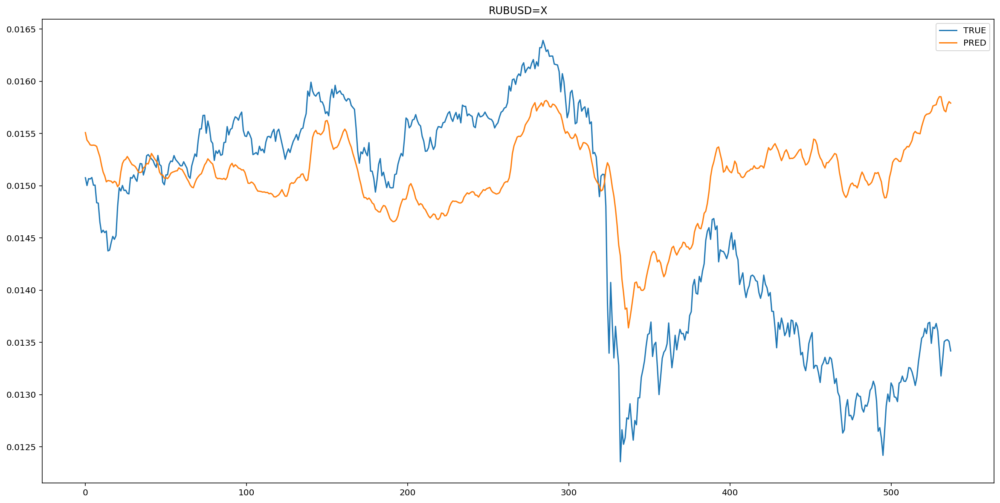

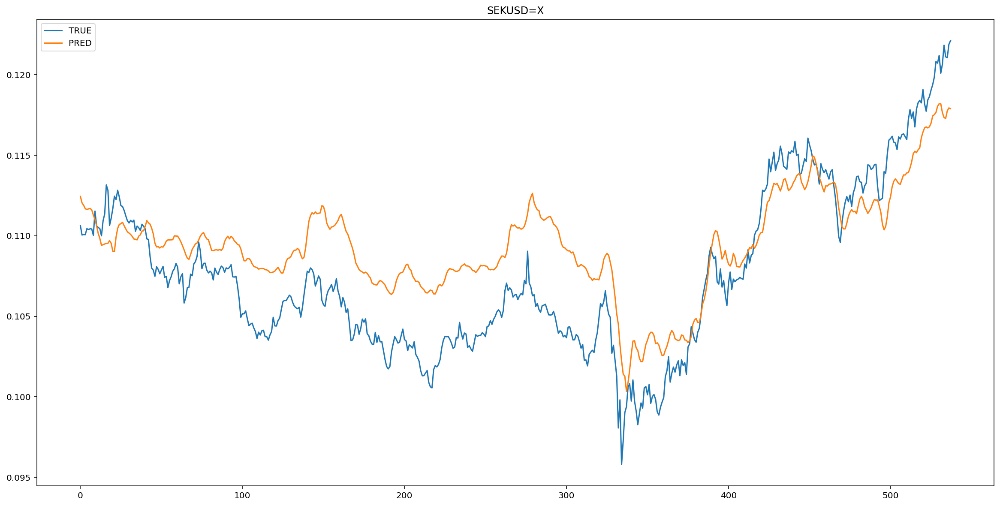

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####GRU

In [ ]:
# design network
model = Sequential()
model.add(GRU(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(GRU(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 2s - loss: 0.3629 - val_loss: 0.1802
Epoch 2/100
4/4 - 0s - loss: 0.2556 - val_loss: 0.1265
Epoch 3/100
4/4 - 0s - loss: 0.1420 - val_loss: 0.0797
Epoch 4/100
4/4 - 0s - loss: 0.0574 - val_loss: 0.0775
Epoch 5/100
4/4 - 0s - loss: 0.0583 - val_loss: 0.0725
Epoch 6/100
4/4 - 0s - loss: 0.0346 - val_loss: 0.0522
Epoch 7/100
4/4 - 0s - loss: 0.0224 - val_loss: 0.0477
Epoch 8/100
4/4 - 0s - loss: 0.0261 - val_loss: 0.0458
Epoch 9/100
4/4 - 0s - loss: 0.0238 - val_loss: 0.0445
Epoch 10/100
4/4 - 0s - loss: 0.0199 - val_loss: 0.0462
Epoch 11/100
4/4 - 0s - loss: 0.0189 - val_loss: 0.0480
Epoch 12/100
4/4 - 0s - loss: 0.0168 - val_loss: 0.0481
Epoch 13/100
4/4 - 0s - loss: 0.0148 - val_loss: 0.0483
Epoch 14/100
4/4 - 0s - loss: 0.0141 - val_loss: 0.0483
Epoch 15/100
4/4 - 0s - loss: 0.0129 - val_loss: 0.0479
Epoch 16/100
4/4 - 0s - loss: 0.0117 - val_loss: 0.0474
Epoch 17/100
4/4 - 0s - loss: 0.0107 - val_loss: 0.0466
Epoch 18/100
4/4 - 0s - loss: 0.0096 - val_loss: 0.0458
E

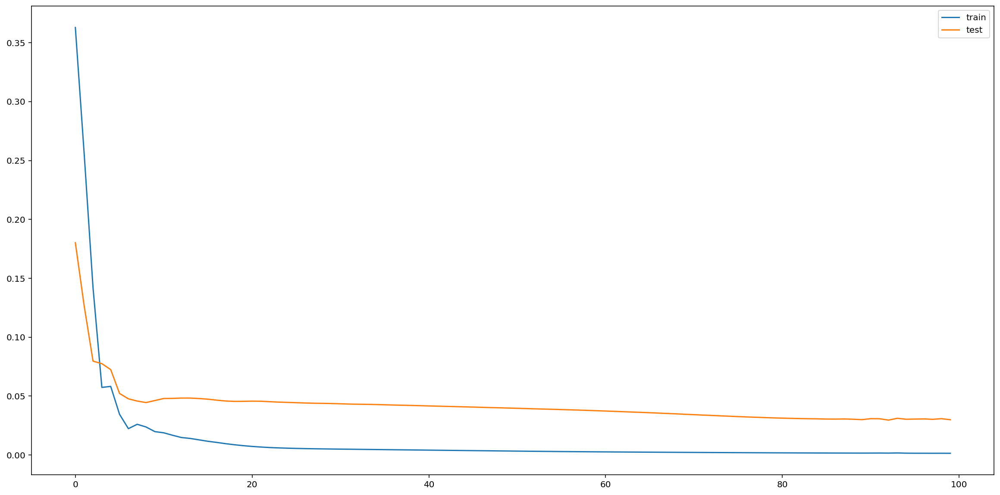

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

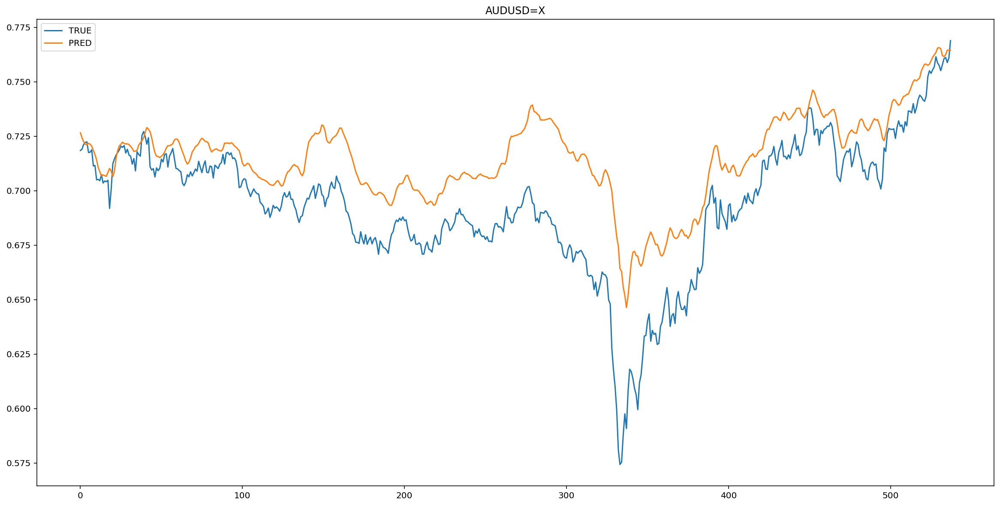

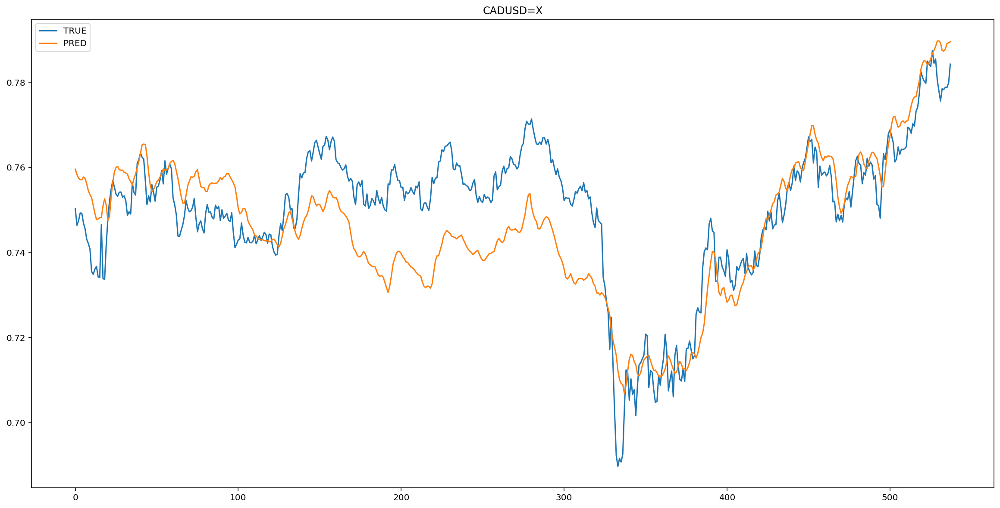

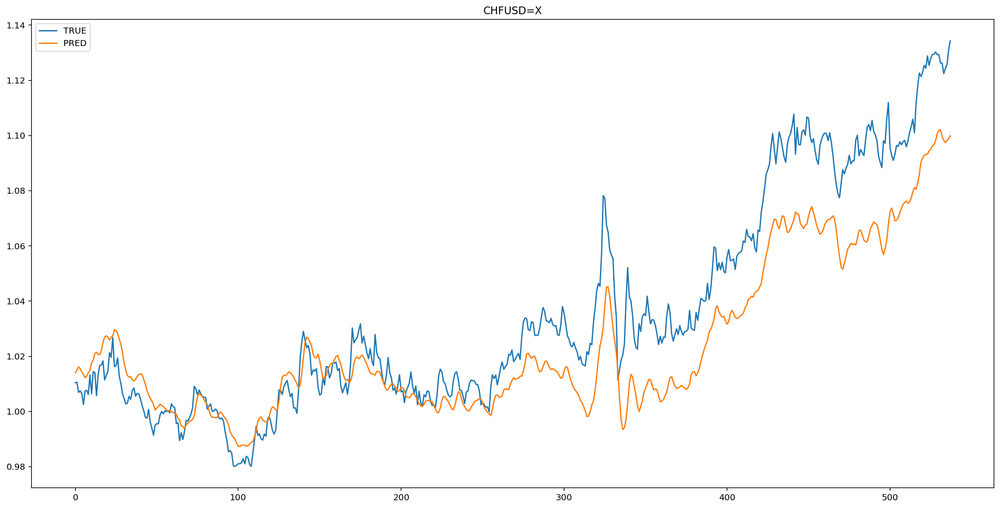

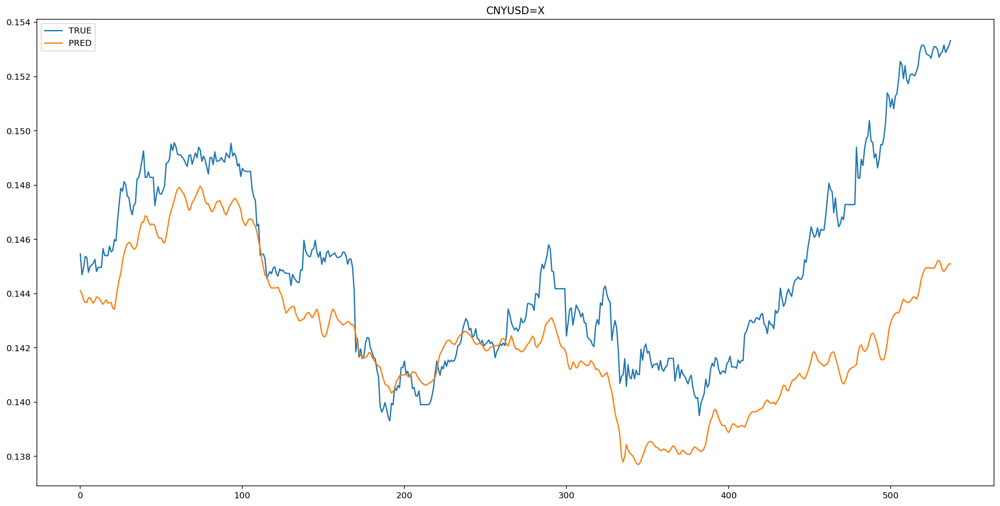

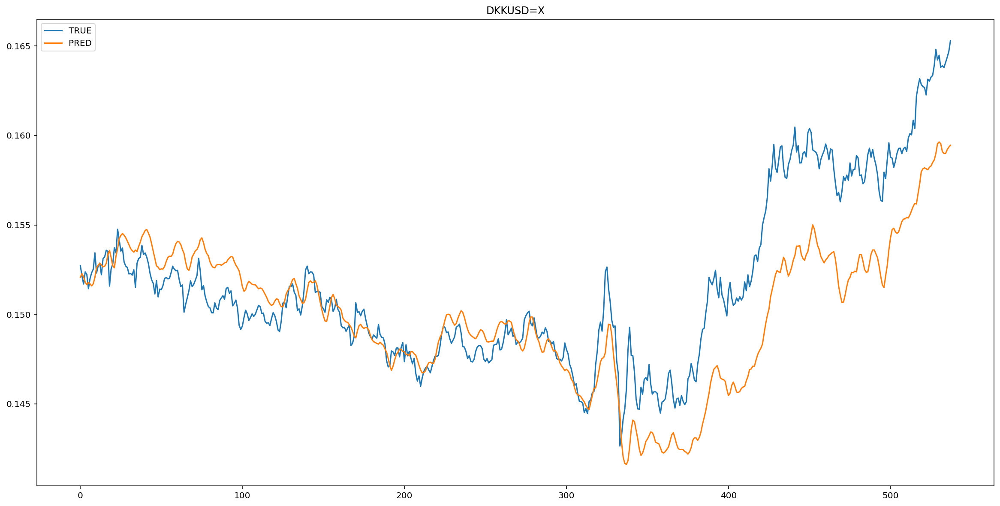

...

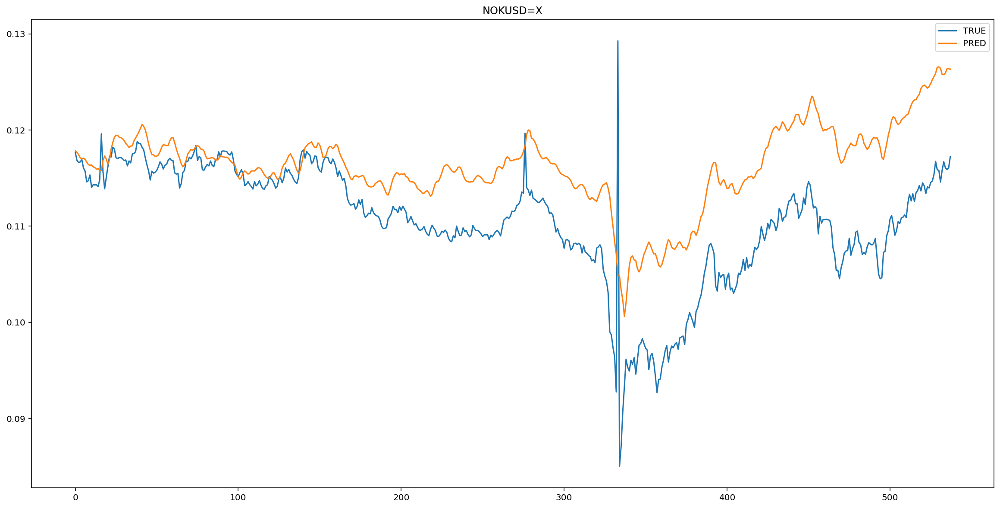

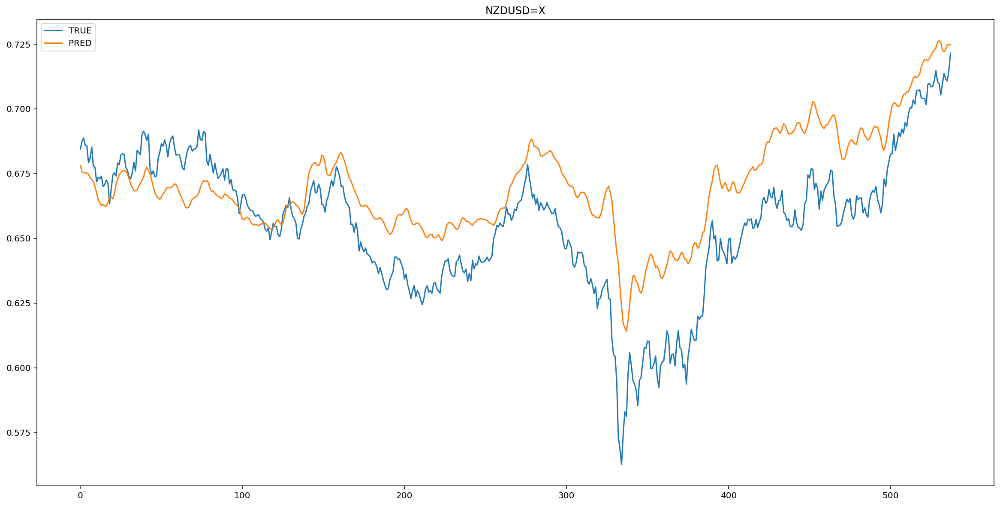

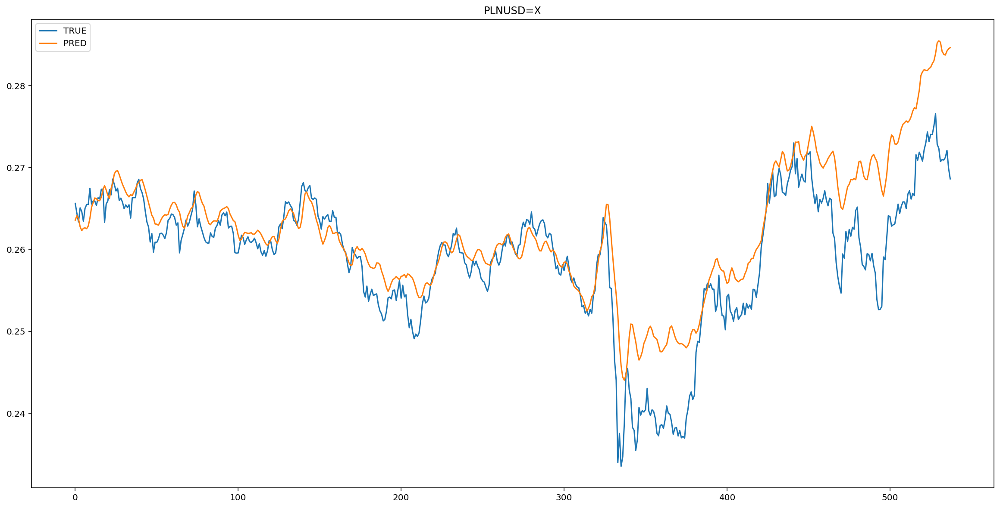

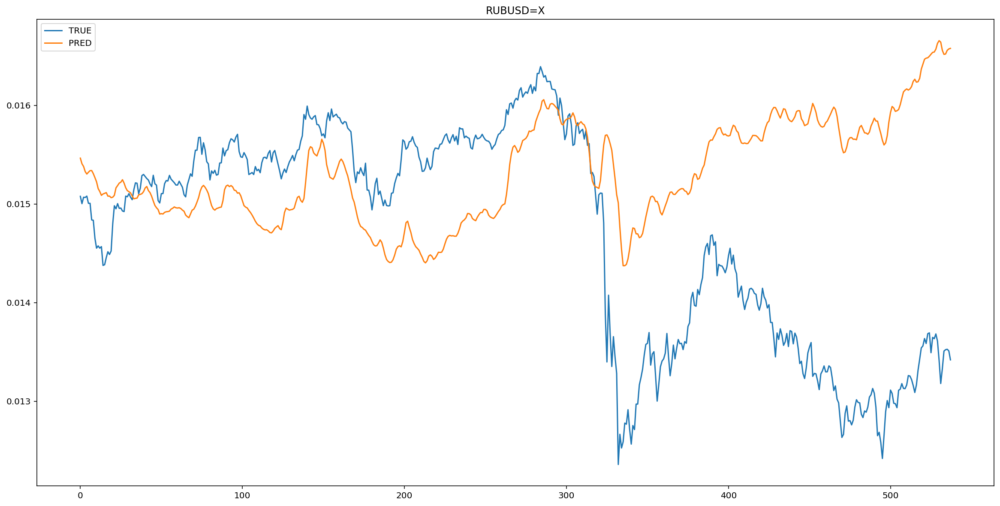

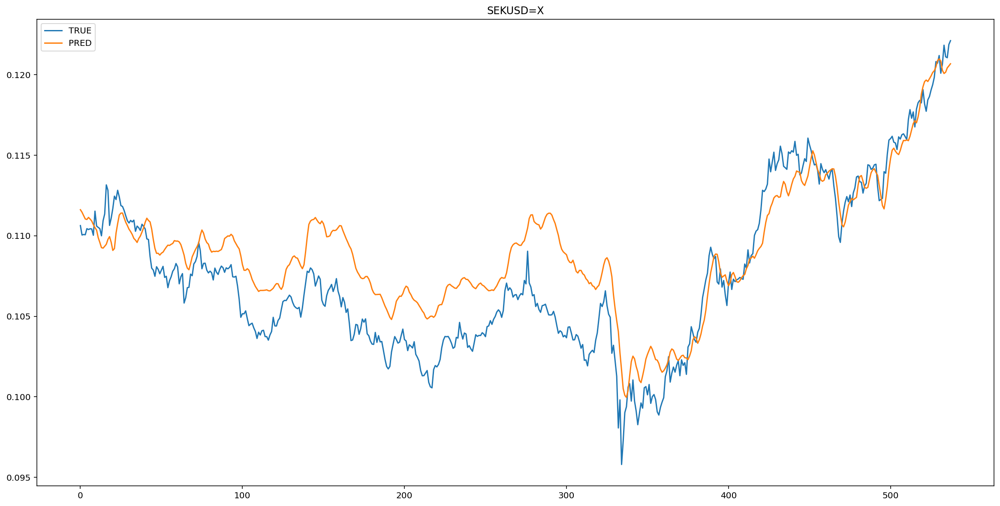

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####Комбинированные

Оцениваем точность

###Комбинации

Оцениваем точность

#Сравнение

Таблица: